In [7]:
import numpy as np
import pandas as pd
import scipy
import scipy.stats
from sklearn import preprocessing
import magic
import math
import rpy2

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sbn

from IPython.display import clear_output
import pickle
import os
import sys

import scanpy as sc
import scanpy.external as sce

from numpy import ones,vstack
from numpy.linalg import lstsq

fig_path = '/mnt/x/karlan/Seq data/Mouse skin/Greco/Katie/Figure_Output'

path_skin_scripts = '/mnt/x/karlan/Python scripts/Skin analysis/scripts/'
sys.path.append(path_skin_scripts)
from Skin_scripts import *

In [3]:
cell_cycle_genes_path = 'X:/karlan/Seq data/regev_lab_cell_cycle_genes.txt'

cell_cycle_genes = [x.strip().title() for x in open(cell_cycle_genes_path)]

# Separate dataset for S-phase or G2M-phase associated genes
s_genes = [x for x in cell_cycle_genes[:43]]
g2m_genes = [x for x in cell_cycle_genes[43:]]

# Import ITGA6-sorted dataset

In [33]:
itga6_path = 'X:/karlan/Seq data/Mouse skin/Greco/Katie'
itga6_adata_raw = sc.read_csv(os.path.join(itga6_path, 'Itga6_sequencing_seq.txt'))

In [34]:
itga6_adata = itga6_adata_raw.copy()

In [35]:
itga6_adata

AnnData object with n_obs × n_vars = 184 × 24487 

# Import Joost 2016 dataset

In [36]:
ife_path = 'X:/karlan/Seq data/Mouse skin/C1_joost_2016/Seq_files/'
ife_adata_raw = sc.read_csv(os.path.join(ife_path, '201509151726_seq_all.txt',), delimiter = '\t').T
ife_adata = ife_adata_raw.copy()

In [37]:
ife_clust_path = 'X:/karlan/Seq data/Mouse skin/C1_joost_2016/Seq_files/'
clusters = pd.read_csv(ife_clust_path + '201509151726_s_groups_1st.txt', sep = '\t', header = None, index_col = 0)
cluster_names = {2:'IFE basal cells (IFE B)',
                 1:'IFE differentiated cells I (IFE DI)',
                 8:'IFE differentiated cells II (IFE DII)',
                 0:'IFE keratinized layer I (IFE KI)',
                 10:'IFE keratinized layer II (IFE KII)',
                 6:'Upper hair follicle I (uHF I)',
                 3:'Upper hair follicle II (uHF II)',
                 4:'Upper hair follicle III (uHF III)',
                 5:'Sebaceous gland (SG)',
                 7:'Outer bulge (OB)',
                 9:'Inner bulge (IB)',
                 11:'T cells (TC)',
                 12:'Langerhans cells (LH)'}

ife_adata.obs['clusters'] = clusters.loc[ife_adata.obs_names].values
ife_adata.obs['named_clusters'] = [cluster_names[x] for x in ife_adata.obs['clusters']]

ife_adata = ife_adata[ife_adata.obs['clusters'].isin([2,1,8,0,10])]

In [38]:
ife_adata

View of AnnData object with n_obs × n_vars = 720 × 26024 
    obs: 'clusters', 'named_clusters'

# Import Joost 2020 dataset

In [17]:
epi_path = 'X:/karlan/Seq data/Mouse skin/Anagen_10x/2019 data/data_output/v1.4'
epi_adata_raw = sc.read_text(os.path.join(epi_path, '201806201840_seq.txt'), delimiter = '\t', first_column_names=True).transpose()

# Combine Joost 2016 and ITGA6 sorted datasets

In [39]:
sc.pp.filter_cells(ife_adata, min_genes = 200)
sc.pp.filter_genes(ife_adata, min_cells = 5)

sc.pp.filter_cells(itga6_adata, min_genes = 200)
sc.pp.filter_genes(itga6_adata, min_cells = 5)

Trying to set attribute `.obs` of view, copying.


In [40]:
ife_adata.var["mito"] = ife_adata.var_names.str.startswith("mt-")
ife_adata.var["ERCC"] = ife_adata.var_names.str.startswith("ERCC-")
sc.pp.calculate_qc_metrics(ife_adata, qc_vars=["mito", "ERCC"], inplace=True)

itga6_adata.var["mito"] = itga6_adata.var_names.str.startswith("mt-")
itga6_adata.var["ERCC"] = itga6_adata.var_names.str.startswith("ERCC-")
sc.pp.calculate_qc_metrics(itga6_adata, qc_vars=["mito", "ERCC"], inplace=True)

... storing 'named_clusters' as categorical


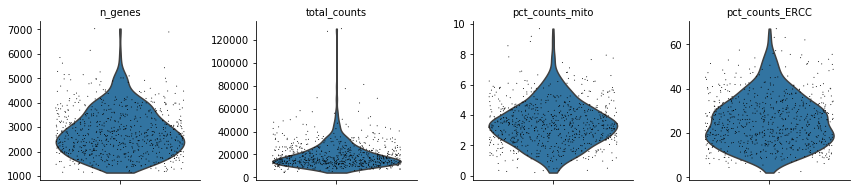

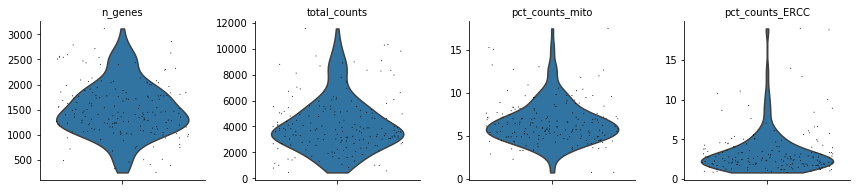

In [41]:
sc.pl.violin(ife_adata, ['n_genes', 'total_counts', 'pct_counts_mito', 'pct_counts_ERCC'],
             jitter=0.4, multi_panel=True)
sc.pl.violin(itga6_adata, ['n_genes', 'total_counts', 'pct_counts_mito', 'pct_counts_ERCC'],
             jitter=0.4, multi_panel=True)

#### Filter cells according to 'n_genes', 'pct_counts_mito', 'pct_counts_ERCC'

In [42]:
qc_vars = ['n_genes','pct_counts_mito','pct_counts_ERCC']
for qc in qc_vars:
    ife_adata = ife_adata[ife_adata.obs[qc] < np.percentile(ife_adata.obs[qc],99)]
    itga6_adata = itga6_adata[itga6_adata.obs[qc] < np.percentile(itga6_adata.obs[qc],99)]

In [43]:
sc.pp.normalize_total(ife_adata)
sc.pp.normalize_total(itga6_adata)

In [44]:
sc.pp.log1p(ife_adata)
sc.pp.log1p(itga6_adata)

In [45]:
sc.pp.log1p(ife_adata_raw)
sc.pp.log1p(itga6_adata_raw)

In [46]:
ife_adata = ife_adata[:,~ife_adata.var_names.str.startswith('ERCC')]
itga6_adata = itga6_adata[:,~itga6_adata.var_names.str.startswith('ERCC')]

In [47]:
sc.pp.highly_variable_genes(ife_adata, min_mean=0.0125, max_mean=3, min_disp=0.5, n_top_genes=4000)
sc.pp.highly_variable_genes(itga6_adata, min_mean=0.0125, max_mean=3, min_disp=0.5, n_top_genes=4000)

Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.


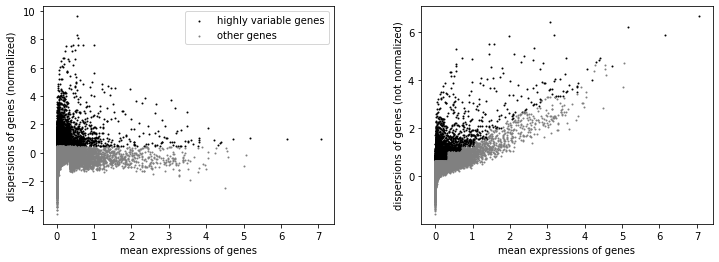

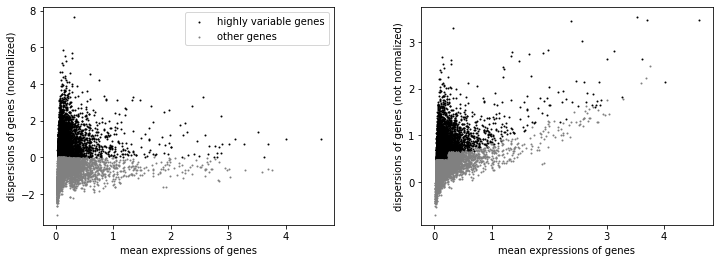

In [48]:
for adata in [ife_adata, itga6_adata]:
    sc.pl.highly_variable_genes(adata)

In [49]:
ife_adata = ife_adata[:, ife_adata.var['highly_variable']]
itga6_adata = itga6_adata[:, itga6_adata.var['highly_variable']]

In [50]:
#Score cell cycle
for adata in [ife_adata, itga6_adata]:
    sc.tl.score_genes_cell_cycle(adata, s_genes=[x for x in s_genes if x in adata.var_names], 
                                       g2m_genes=[x for x in g2m_genes if x in adata.var_names])

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


In [51]:
for adata in [ife_adata, itga6_adata]:
    sc.pp.regress_out(adata, ['total_counts','pct_counts_ERCC'])
    sc.pp.regress_out(adata, ['S_score', 'G2M_score'])

... storing 'phase' as categorical
... storing 'phase' as categorical


In [52]:
for adata in [ife_adata, itga6_adata]:
    sc.pp.scale(adata, max_value=10)

In [53]:
adata_combined = ife_adata.concatenate(itga6_adata, batch_categories=['ife','itga6'])

# Combine with Joost 2020 dataset

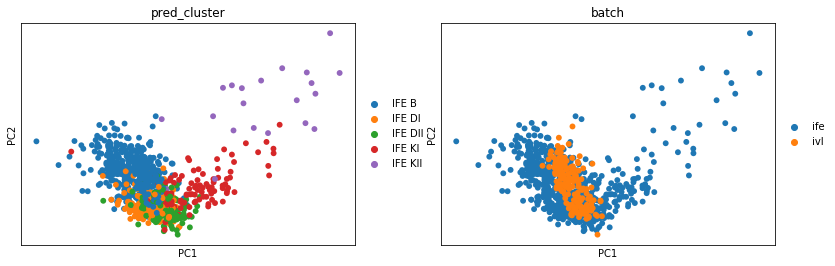

In [104]:
sc.pp.pca(adata)
sc.pl.pca(adata, color = ['pred_cluster', 'batch'])

In [107]:
sc.pp.neighbors(adata, n_pcs = 20, n_neighbors=25)

In [108]:
sc.tl.umap(adata, spread = 1, min_dist = 0.5)

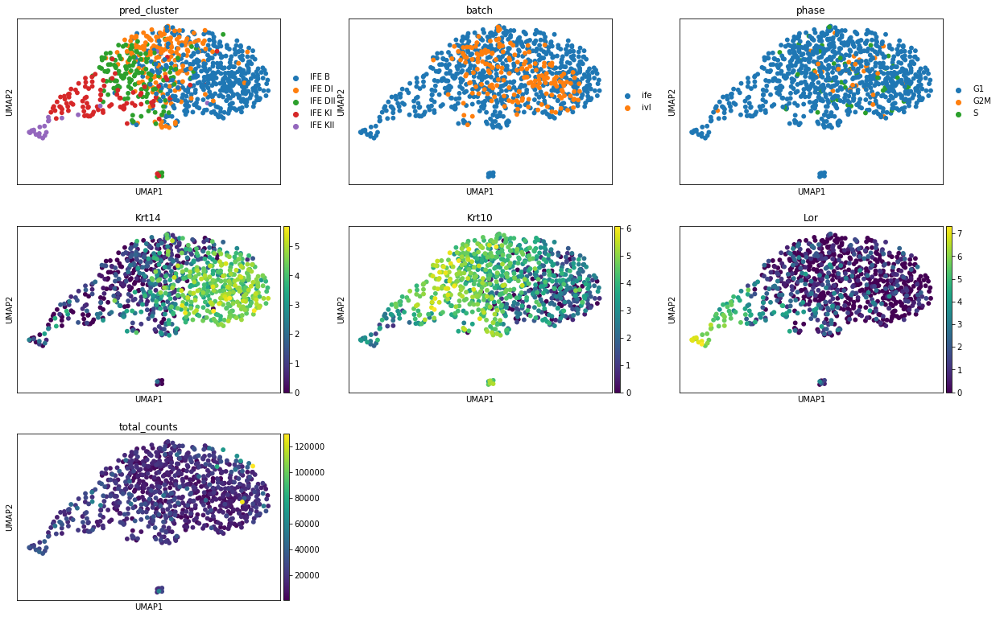

In [50]:
sc.pl.umap(adata, color = ['pred_cluster', 'batch', 'phase', 'Krt14','Krt10','Lor', 'total_counts'], ncols = 3)

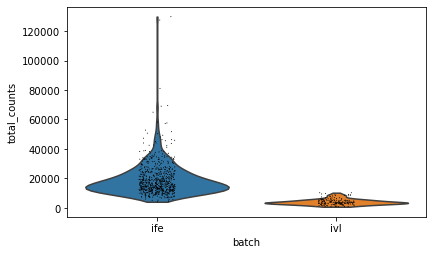

In [109]:
sc.pl.violin(adata, keys = 'total_counts', groupby = 'batch')

In [ ]:
epi_adata = epidata_raw.copy()

epi_path = 'X:/karlan/Seq data/Mouse skin/Anagen_10x/2019 data/data_output/v1.4'
epi_cluster_names = ['EPI - 0', 'EPI - 1', 'EPI - 2', 'EPI - 3']

epi_clusters = pd.read_csv(os.path.join(epi_path, '201806201840_cl_c_EPI.txt'), sep = '\t', index_col = 0, header = None)
epi_cells = epi_clusters.loc[epi_clusters.isin(epi_cluster_names).values.flatten()].index
epi_adata = epi_adata[epi_cells]
epi_adata.obs['named_clusters'] = epi_clusters.loc[epi_adata.obs_names]

In [113]:
sc.pp.filter_genes(epi_adata, min_cells=5)
sc.pp.calculate_qc_metrics(epi_adata, inplace = True)
sc.pp.normalize_total(epi_adata)
sc.pp.log1p(epi_adata)

Trying to set attribute `.var` of view, copying.


Text(0.5, 1.0, 'Normalized counts')

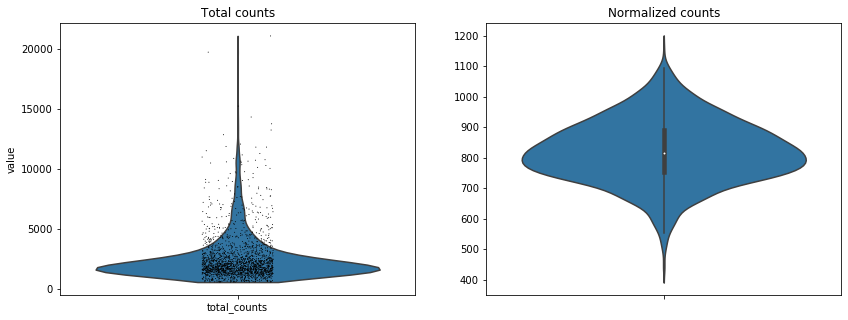

In [114]:
fig, axes = plt.subplots(ncols = 2, figsize = (14, 5))
sc.pl.violin(epi_adata, 'total_counts', ax = axes[0], show = False)
sbn.violinplot(np.sum(epi_adata.X, axis = 1), orient='v', ax = axes[1])
axes[0].set_title('Total counts')
axes[1].set_title('Normalized counts')

In [120]:
epi_adata = epi_adata[:, adata.var_names.intersection(epi_adata.var_names)]
adata = adata[:, adata.var_names.intersection(epi_adata.var_names)]

In [298]:
epi_adata

View of AnnData object with n_obs × n_vars = 1927 × 990 
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'

In [121]:
sc.tl.score_genes_cell_cycle(epi_adata, s_genes = s_genes, g2m_genes=g2m_genes)

Trying to set attribute `.obs` of view, copying.


In [122]:
sc.pp.regress_out(epi_adata, keys = ['S_score', 'G2M_score'])
sc.pp.scale(epi_adata)

... storing 'phase' as categorical


Text(0.5, 1.0, '10x')

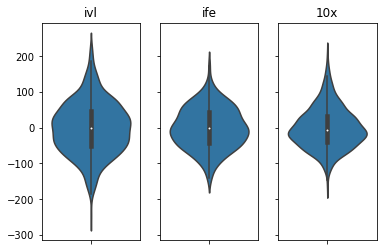

In [59]:
fig, axes= plt.subplots(ncols = 3, sharey = True)

for ix, batch in enumerate(['ife','ivl']):
    ax = axes[ix]
    data = adata[adata.obs['batch']==batch]
    sbn.violinplot(np.sum(data.X, axis = 1), orient='v', ax = ax)
    ax.set_title(['ivl','ife','10x'][ix])
    #ax.set_ylim([0,6000])

sbn.violinplot(np.sum(epi_adata.X, axis = 1), orient='v', ax = axes[2])
axes[2].set_title('10x')

# Attempts to map datasets to one UMAP and shared clustering with ingest
This approach didn't work out, but clustering information is plotted on a few subsequent umaps. However, the clustering information was also not used for the final analysis.

In [130]:
sc.pp.pca(epi_adata)

In [131]:
sc.tl.ingest(epi_adata, adata, obs = 'pred_cluster')

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\numba\typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "..\..\..\..\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\umap\nndescent.py", line 124:
    @numba.njit(parallel=True)
    def init_from_random(n_neighbors, data, query_points, heap, rng_state):
    ^

  state.func_ir.loc))


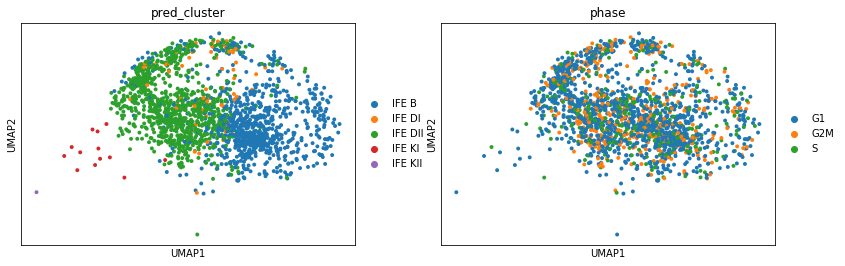

In [132]:
sc.pl.umap(epi_adata, color = ['pred_cluster', 'phase'])

In [133]:
comb_adata = adata.concatenate(epi_adata, batch_categories=['C1','10x'])

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\anndata\_core\anndata.py:1880: UserWarning: Only some adata objects have `.raw` attribute, not concatenating `.raw` attributes.
  UserWarning,


In [134]:
cell_identity = []
for x in comb_adata.obs_names:
    if 'ife' in x:
        cell_identity.append('ife')
    elif 'minus' in x:
        cell_identity.append('Tomato-')
    elif 'plus' in x:
        cell_identity.append('Tomato+')
    else:
        cell_identity.append('10x')
comb_adata.obs['cell_identity'] = cell_identity

... storing 'Krt10_group' as categorical
... storing 'Krt14_group' as categorical
... storing 'cell_identity' as categorical
... storing 'clustering' as categorical
... storing 'layer' as categorical
... storing 'leiden' as categorical
... storing 'phase_c0' as categorical
... storing 'phase_c0.05' as categorical
... storing 'phase_c0.1' as categorical
... storing 'phase_c0.2' as categorical
... storing 'phase_separate_original' as categorical


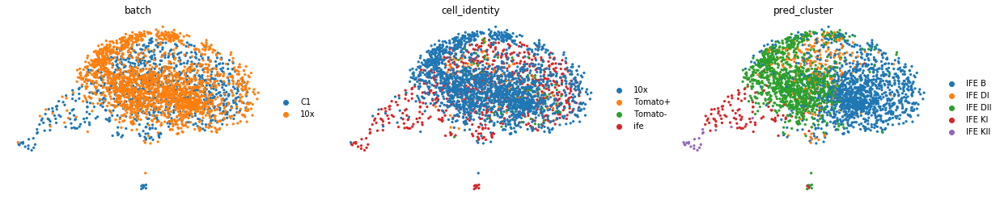

In [135]:
sc.pl.umap(comb_adata, color = ['batch', 'cell_identity', 'pred_cluster'], frameon = False)

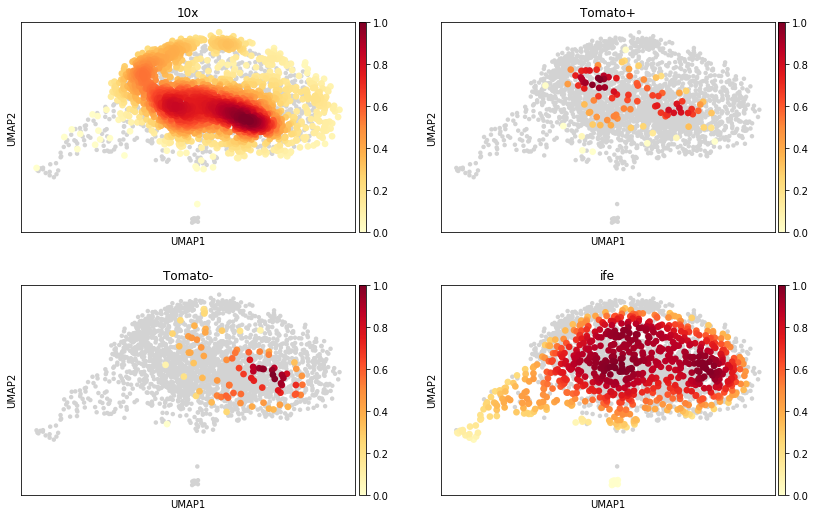

In [136]:
sc.tl.embedding_density(comb_adata, basis = 'umap', groupby = 'cell_identity')
sc.pl.embedding_density(comb_adata, groupby = 'cell_identity', ncols = 2)

In [150]:
comb_adata = comb_adata[:, comb_adata.X.sum(axis = 0)!=0]

## Use MAGIC to impute missing data

10


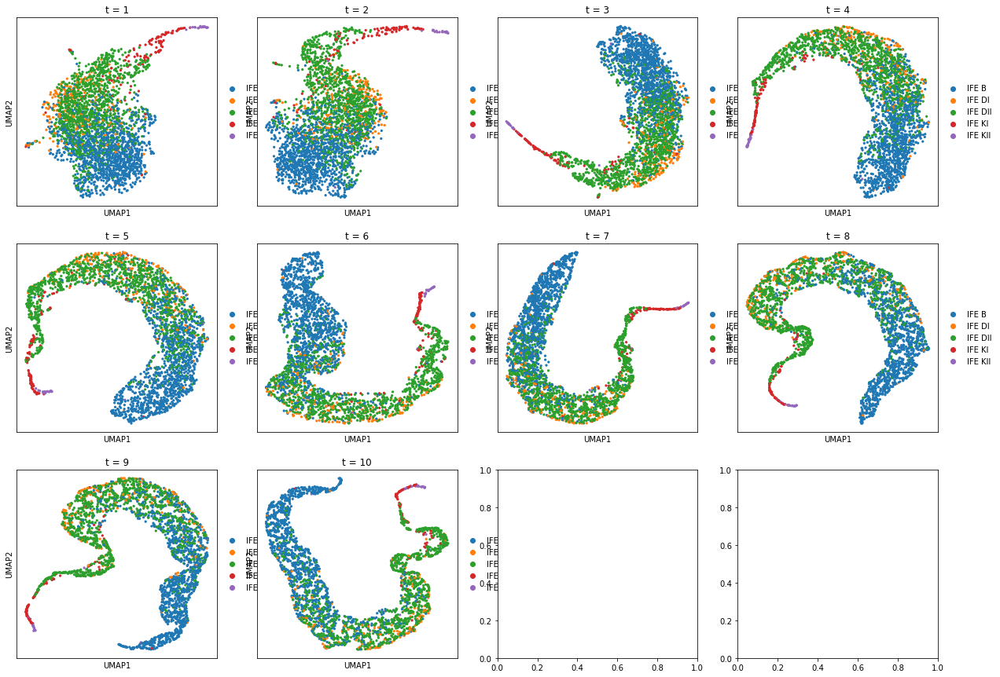

In [528]:
t_range = np.arange(1,11)

plots = len(t_range)
ncols = 4
nrows = int(np.ceil(plots/ncols))
fig, axes= plt.subplots(ncols = ncols, nrows = nrows, figsize = (21, 5*nrows))

for ix, t in enumerate(t_range):
    clear_output(wait=True)
    print(t)
    ax = axes[ix//ncols, ix%ncols]
    tmp = sce.pp.magic(comb_adata, name_list='all_genes', knn=10, copy = True, t = t)
    sc.pp.pca(tmp)
    sc.pp.neighbors(tmp)
    sc.tl.umap(tmp)
    sc.pl.umap(tmp, color = 'pred_cluster', show = False, ax = ax)
    ax.set_title('t = {}'.format(t))

10


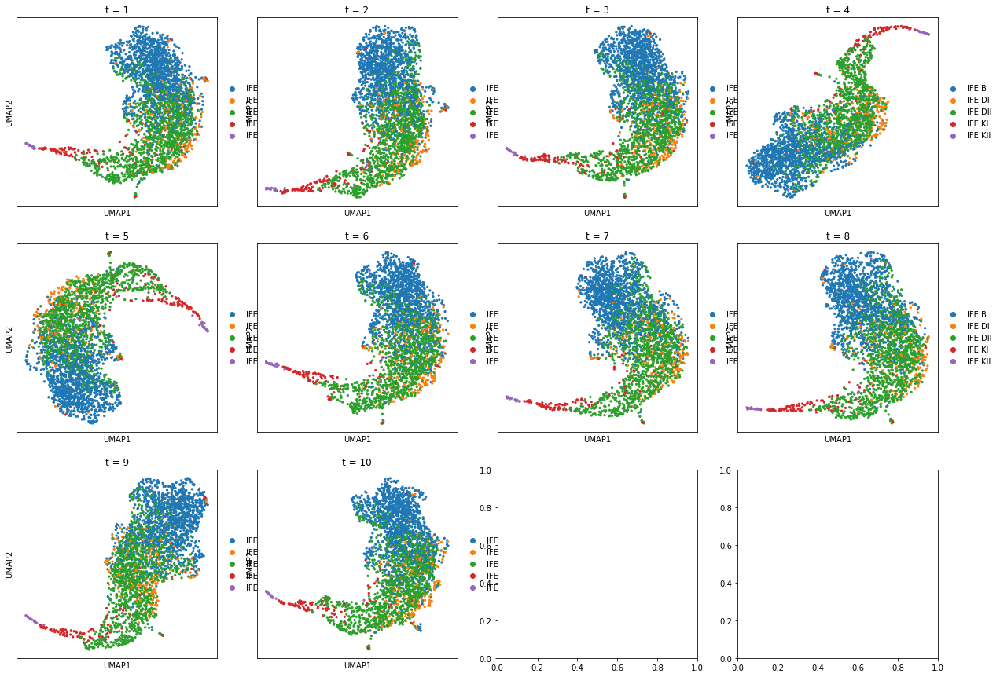

In [531]:
t_range = np.arange(1,11)

plots = len(t_range)
ncols = 4
nrows = int(np.ceil(plots/ncols))
fig, axes= plt.subplots(ncols = ncols, nrows = nrows, figsize = (21, 5*nrows))

for ix, t in enumerate(t_range):
    clear_output(wait=True)
    print(t)
    ax = axes[ix//ncols, ix%ncols]
    tmp = sce.pp.magic(comb_adata, name_list='all_genes', knn=10, copy = True, t = 2)
    sc.pp.pca(tmp)
    sc.pp.neighbors(tmp)
    sc.tl.umap(tmp)
    sc.pl.umap(tmp, color = 'pred_cluster', show = False, ax = ax)
    ax.set_title('t = {}'.format(t))

12


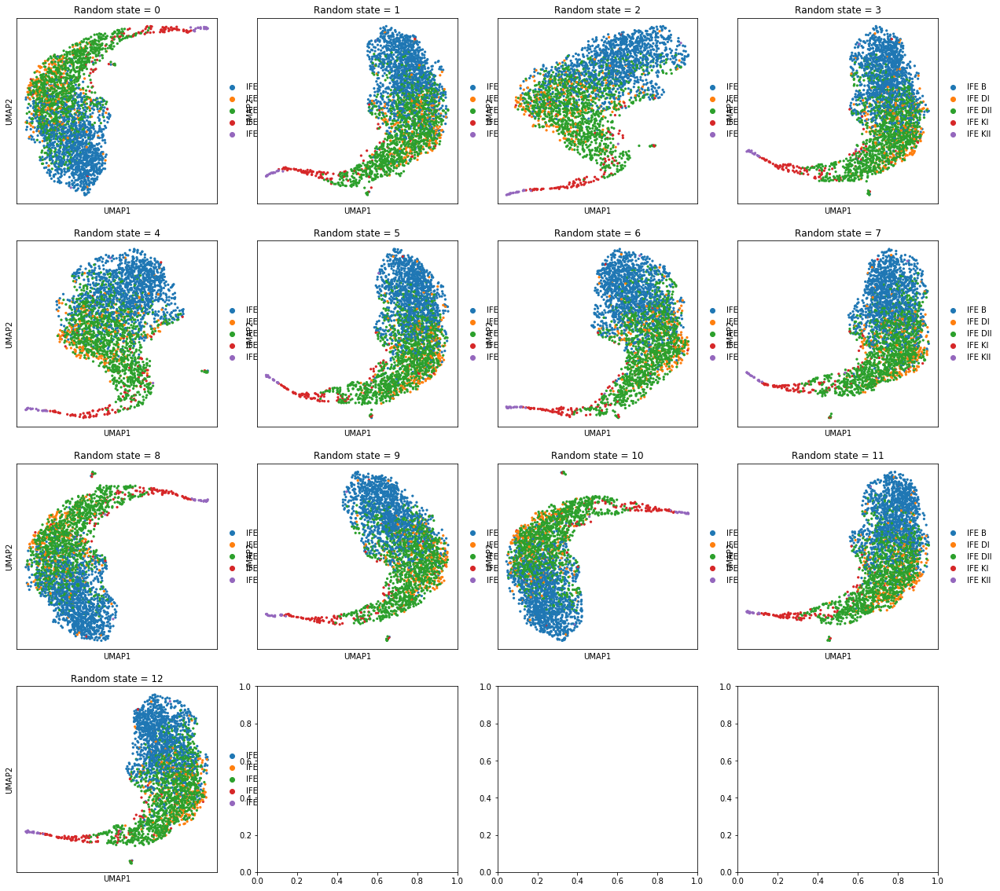

In [152]:
rnd_state = np.arange(0,13)

plots = len(rnd_state)
ncols = 4
nrows = int(np.ceil(plots/ncols))
fig, axes= plt.subplots(ncols = ncols, nrows = nrows, figsize = (21, 5*nrows))

for ix, rnd in enumerate(rnd_state):
    clear_output(wait=True)
    print(rnd)
    ax = axes[ix//ncols, ix%ncols]
    tmp = sce.pp.magic(comb_adata, name_list='all_genes', knn=10, copy = True, t = 2, random_state=rnd)
    sc.pp.pca(tmp)
    sc.pp.neighbors(tmp)
    sc.tl.umap(tmp)
    sc.pl.umap(tmp, color = 'pred_cluster', show = False, ax = ax)
    ax.set_title('Random state = {}'.format(rnd))

12


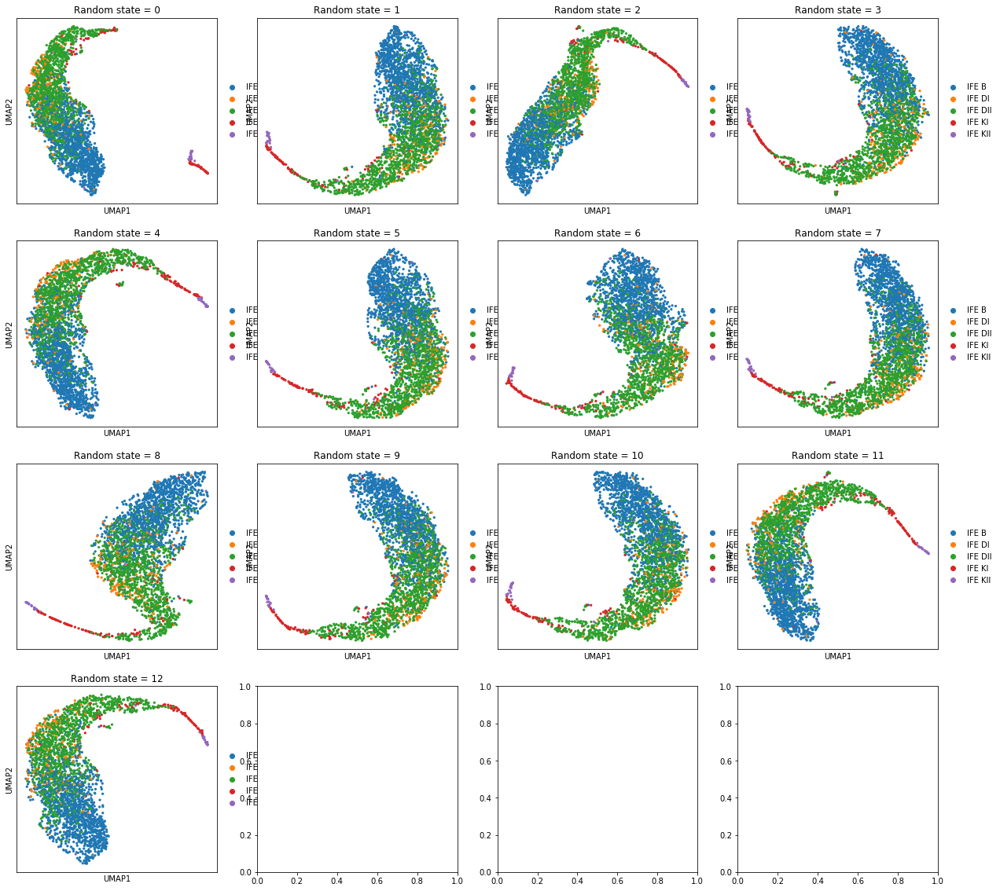

In [153]:
rnd_state = np.arange(0,13)

plots = len(rnd_state)
ncols = 4
nrows = int(np.ceil(plots/ncols))
fig, axes= plt.subplots(ncols = ncols, nrows = nrows, figsize = (21, 5*nrows))

for ix, rnd in enumerate(rnd_state):
    clear_output(wait=True)
    print(rnd)
    ax = axes[ix//ncols, ix%ncols]
    tmp = sce.pp.magic(comb_adata, name_list='all_genes', knn=10, copy = True, t = 3, random_state=rnd)
    sc.pp.pca(tmp)
    sc.pp.neighbors(tmp)
    sc.tl.umap(tmp)
    sc.pl.umap(tmp, color = 'pred_cluster', show = False, ax = ax)
    ax.set_title('Random state = {}'.format(rnd))

50


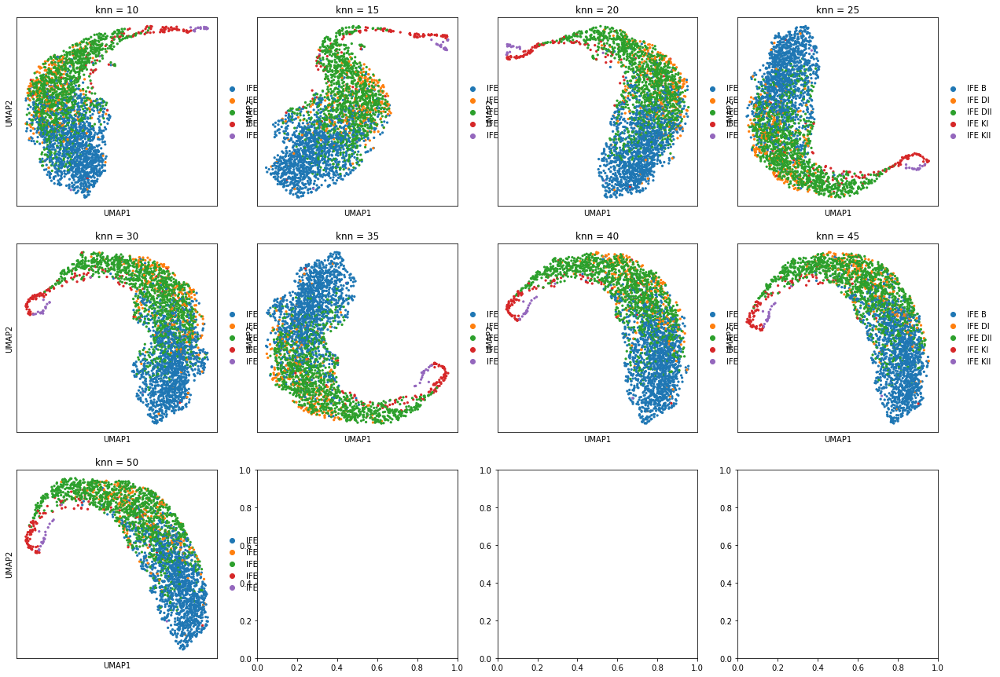

In [156]:
knn_range = np.arange(10,51, 5)

plots = len(knn_range)
ncols = 4
nrows = int(np.ceil(plots/ncols))
fig, axes= plt.subplots(ncols = ncols, nrows = nrows, figsize = (21, 5*nrows))

for ix, knn in enumerate(knn_range):
    clear_output(wait=True)
    print(knn)
    ax = axes[ix//ncols, ix%ncols]
    tmp = sce.pp.magic(comb_adata, name_list='all_genes', knn=knn, copy = True, t = 2, random_state = 0)
    sc.pp.pca(tmp)
    sc.pp.neighbors(tmp)
    sc.tl.umap(tmp)
    sc.pl.umap(tmp, color = 'pred_cluster', show = False, ax = ax)
    ax.set_title('knn = {}'.format(knn))

50


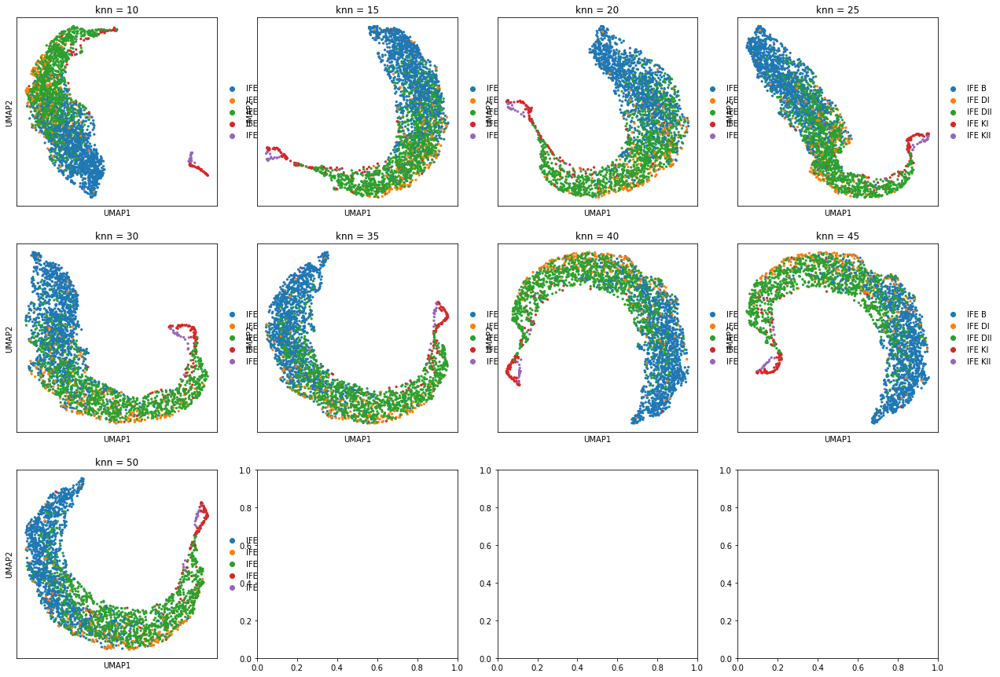

In [157]:
knn_range = np.arange(10,51, 5)

plots = len(knn_range)
ncols = 4
nrows = int(np.ceil(plots/ncols))
fig, axes= plt.subplots(ncols = ncols, nrows = nrows, figsize = (21, 5*nrows))

for ix, knn in enumerate(knn_range):
    clear_output(wait=True)
    print(knn)
    ax = axes[ix//ncols, ix%ncols]
    tmp = sce.pp.magic(comb_adata, name_list='all_genes', knn=knn, copy = True, t = 3, random_state = 0)
    sc.pp.pca(tmp)
    sc.pp.neighbors(tmp)
    sc.tl.umap(tmp)
    sc.pl.umap(tmp, color = 'pred_cluster', show = False, ax = ax)
    ax.set_title('knn = {}'.format(knn))

99


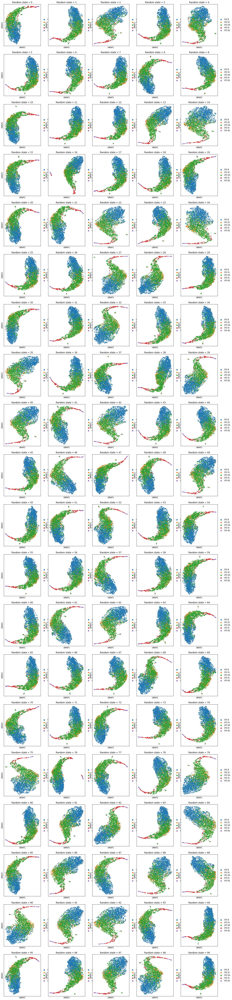

In [154]:
rnd_state = np.arange(0,100)

plots = len(rnd_state)
ncols = 5
nrows = int(np.ceil(plots/ncols))
fig, axes= plt.subplots(ncols = ncols, nrows = nrows, figsize = (21, 5*nrows))

for ix, rnd in enumerate(rnd_state):
    clear_output(wait=True)
    print(rnd)
    ax = axes[ix//ncols, ix%ncols]
    tmp = sce.pp.magic(comb_adata, name_list='all_genes', knn=10, copy = True, t = 2, random_state=rnd)
    sc.pp.pca(tmp)
    sc.pp.neighbors(tmp)
    sc.tl.umap(tmp)
    sc.pl.umap(tmp, color = 'pred_cluster', show = False, ax = ax)
    ax.set_title('Random state = {}'.format(rnd))

99


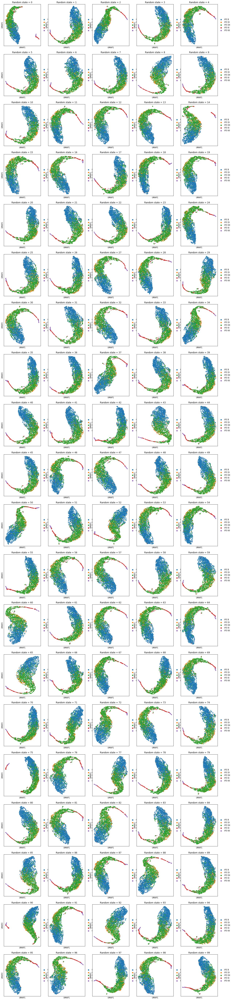

In [155]:
rnd_state = np.arange(0,100)

plots = len(rnd_state)
ncols = 5
nrows = int(np.ceil(plots/ncols))
fig, axes= plt.subplots(ncols = ncols, nrows = nrows, figsize = (21, 5*nrows))

for ix, rnd in enumerate(rnd_state):
    clear_output(wait=True)
    print(rnd)
    ax = axes[ix//ncols, ix%ncols]
    tmp = sce.pp.magic(comb_adata, name_list='all_genes', knn=10, copy = True, t = 3, random_state=rnd)
    sc.pp.pca(tmp)
    sc.pp.neighbors(tmp)
    sc.tl.umap(tmp)
    sc.pl.umap(tmp, color = 'pred_cluster', show = False, ax = ax)
    ax.set_title('Random state = {}'.format(rnd))

67


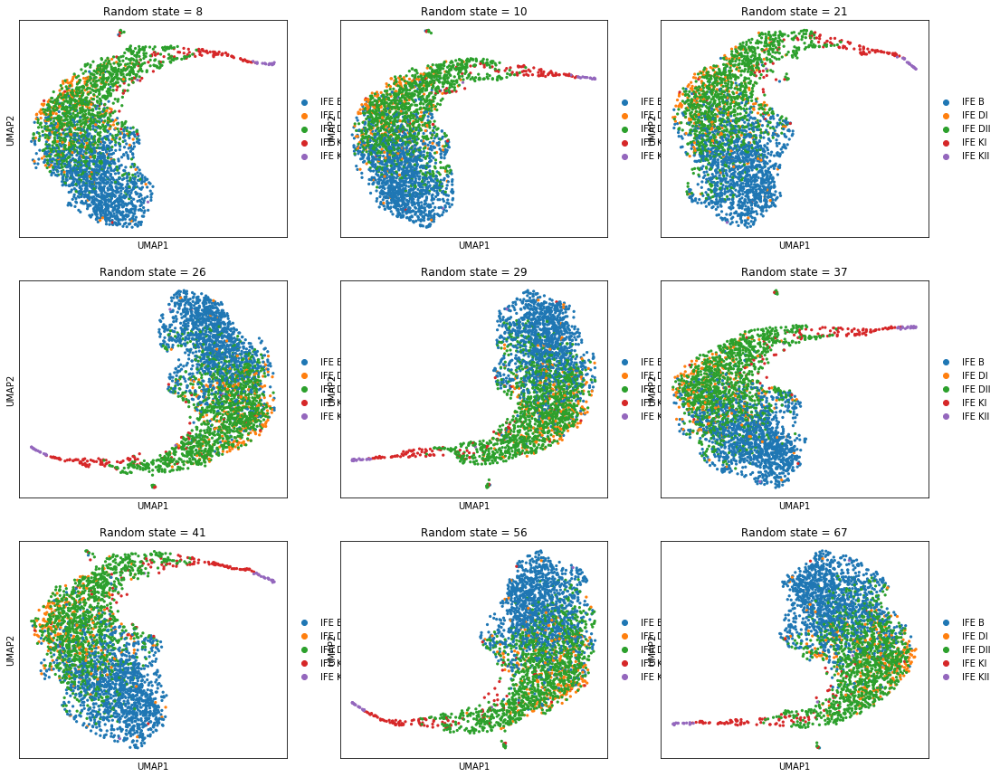

In [159]:
rnd_state = [8,10,21,26,29,37,41,56,67]

plots = len(rnd_state)
ncols = 3
nrows = int(np.ceil(plots/ncols))
fig, axes= plt.subplots(ncols = ncols, nrows = nrows, figsize = (6*ncols, 5*nrows))

for ix, rnd in enumerate(rnd_state):
    clear_output(wait=True)
    print(rnd)
    ax = axes[ix//ncols, ix%ncols]
    tmp = sce.pp.magic(comb_adata, name_list='all_genes', knn=10, copy = True, t = 2, random_state=rnd)
    sc.pp.pca(tmp)
    sc.pp.neighbors(tmp)
    sc.tl.umap(tmp)
    sc.pl.umap(tmp, color = 'pred_cluster', show = False, ax = ax)
    ax.set_title('Random state = {}'.format(rnd))

# Selected important paramaters for MAGIC imputation:
knn = 10

t = 2

random_state = 41

In [ ]:
data_magic = sce.pp.magic(comb_adata, name_list='all_genes', knn=10, copy = True, t = 2, random_state = 41)

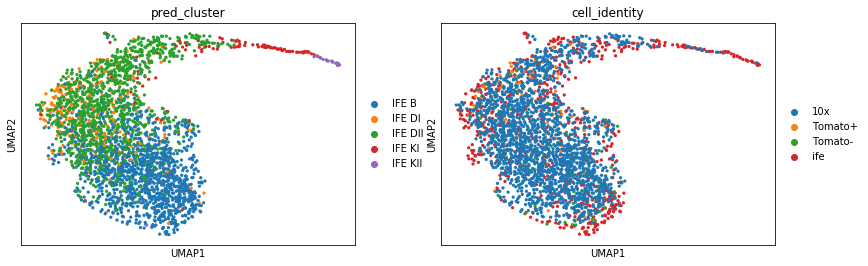

In [162]:
sc.pp.pca(data_magic)
sc.pp.neighbors(data_magic)
sc.tl.umap(data_magic)
sc.pl.umap(data_magic, color = ['pred_cluster', 'cell_identity'], ncols = 2)

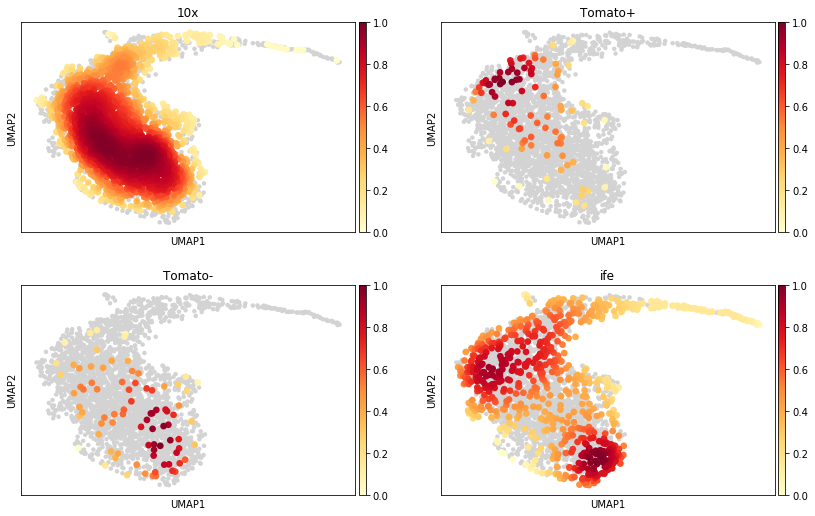

In [163]:
sc.tl.embedding_density(data_magic, basis = 'umap', groupby = 'cell_identity')
sc.pl.embedding_density(data_magic, groupby = 'cell_identity', ncols = 2)

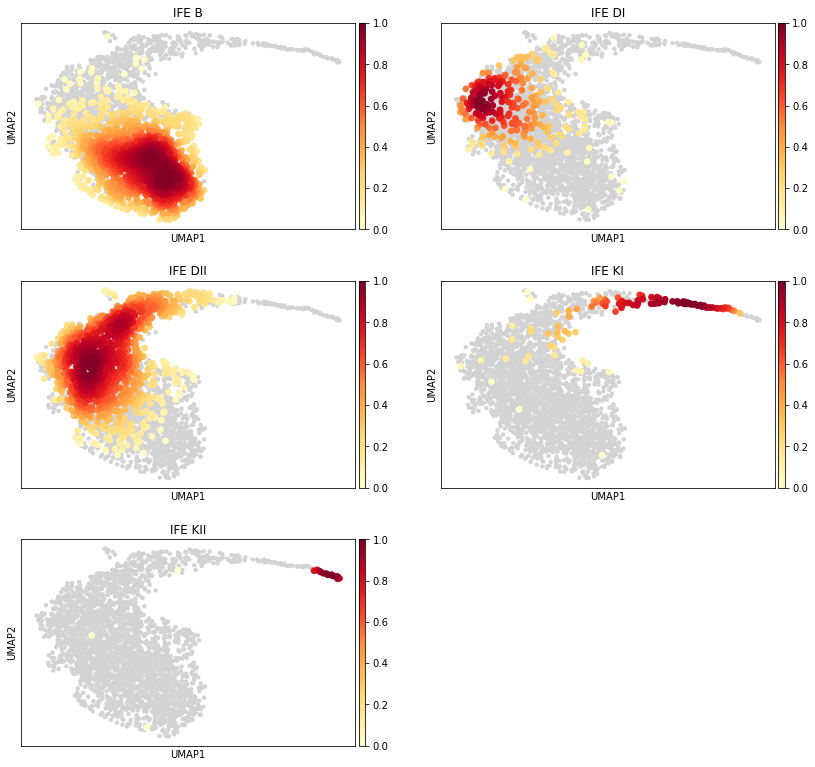

In [164]:
sc.tl.embedding_density(data_magic, basis = 'umap', groupby = 'pred_cluster')
sc.pl.embedding_density(data_magic, groupby = 'pred_cluster', ncols = 2)

In [181]:
data_magic.raw = ife_adata.concatenate(ivl_adata, epi_adata)

In [182]:
tmp_10x = data_magic[data_magic.obs['batch'] == '10x',:]

Trying to set attribute `.uns` of view, copying.


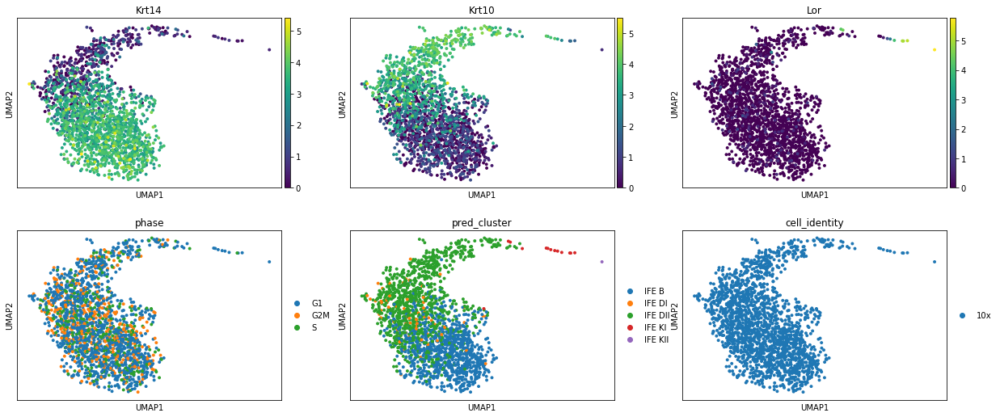

In [184]:
sc.pl.umap(tmp_10x, color = ['Krt14','Krt10','Lor','phase','pred_cluster','cell_identity'], ncols = 3)

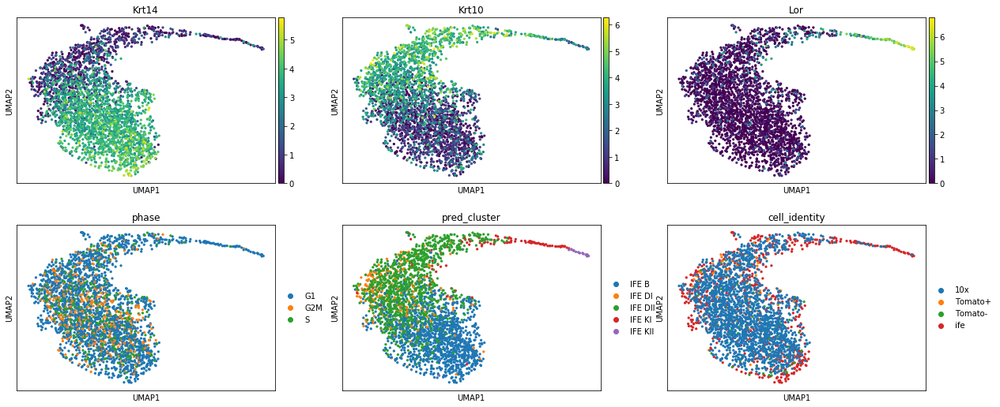

In [185]:
sc.pl.umap(data_magic, color = ['Krt14','Krt10','Lor','phase','pred_cluster','cell_identity'], ncols = 3)

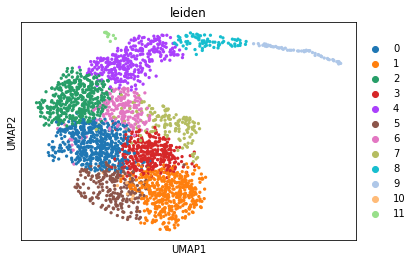

In [198]:
sc.tl.leiden(data_magic, resolution = 0.9)
sc.pl.umap(data_magic, color = 'leiden')

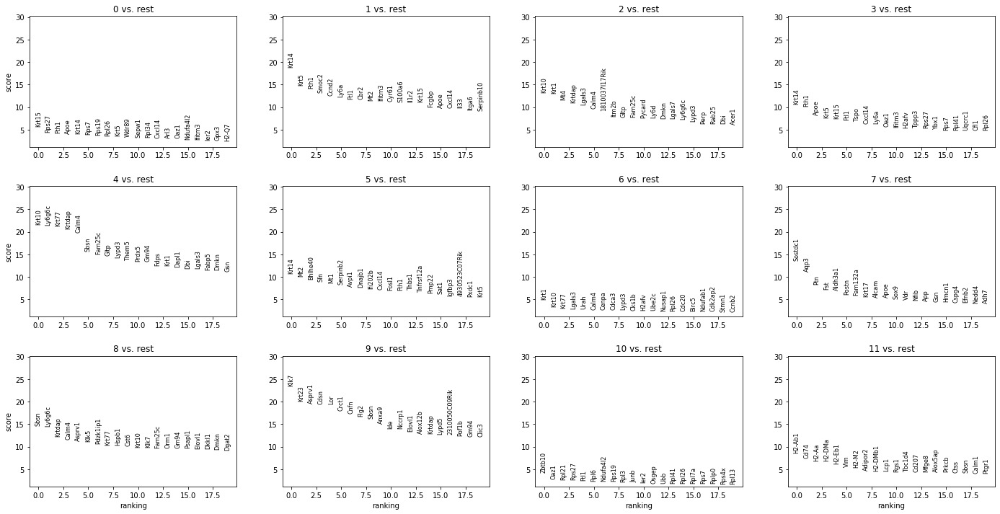

In [199]:
sc.tl.rank_genes_groups(data_magic, groupby = 'leiden')
sc.pl.rank_genes_groups(data_magic)

### Remove infundibulum cells (leiden cluster 7) and a small outlier cluster (leiden cluster 11)

In [203]:
data_magic = data_magic[~data_magic.obs['leiden'].isin(['7','11']),:]

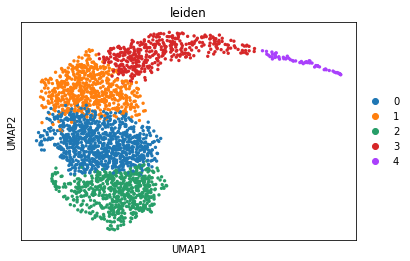

In [236]:
sc.tl.leiden(data_magic, resolution = 0.5)
sc.pl.umap(data_magic, color = 'leiden')

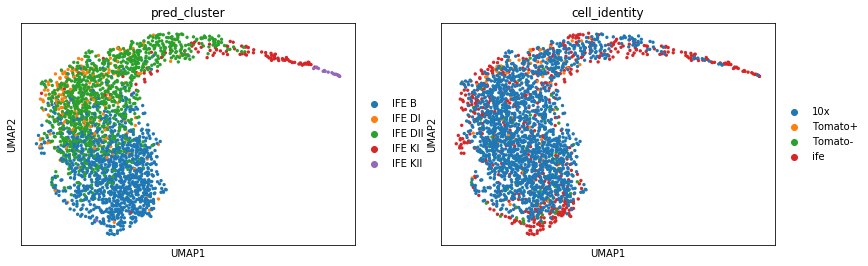

In [221]:
sc.pp.pca(data_magic)
sc.pp.neighbors(data_magic)
sc.tl.umap(data_magic)
sc.pl.umap(data_magic, color = ['pred_cluster', 'cell_identity'], ncols = 2)

### Run MST based on umap without infundibulum

In [222]:
umap = pd.DataFrame(data = data_magic.obsm['X_umap'], index = data_magic.obs_names)

In [223]:
scipy_dist_mat = scipy.spatial.distance.pdist(data_magic.obsm['X_umap'])
scipy_dist_mat = scipy.spatial.distance.squareform(scipy_dist_mat)
dist_mat = pd.DataFrame(data = scipy_dist_mat, index = data_magic.obs_names, columns = data_magic.obs_names)

In [224]:
#generate MST and diameter path based on correlation-defined edge weight

MST, MST_pos = PTO_create_MST_2d(dist_mat)

Adding MST edges: 2645/2645
Creating MST
Creating MST_pos


In [225]:
diam_edges = PTO_diameter_path(MST, return_edges = True)

In [226]:
MST_pos_umap = {}

for cell in umap.index:
    
    MST_pos_umap[cell] = (umap[0].loc[cell], umap[1].loc[cell])

MST_ = MST.copy() #Full cell labels

MST, node_dict = PTO_relabel_nodes(MST)

dist_int = PTO_distance_matrix_2d(dist_mat, node_dict)

print('\nCreating PQ-Tree\n')

PQ = PTO_PQ_tree(MST)

print('Finding permutations\n')

PTO = PTO_PQ_simple_permutations(PQ, dist_int, return_min = 50)

PTO_coords = PTO_ordered_coordinates(PTO, node_dict, dist_int)

MST = MST_

data_magic.obs['pto_coords'] = PTO_coords.values

Calculating PTO: 409/410


C:/Users/karlan/Documents/Python/Projects\MST_scripts_202002.py:401: FutureWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ix-indexer-is-deprecated
  dist += dist_int.ix[PTO[pos -1], PTO[pos]]


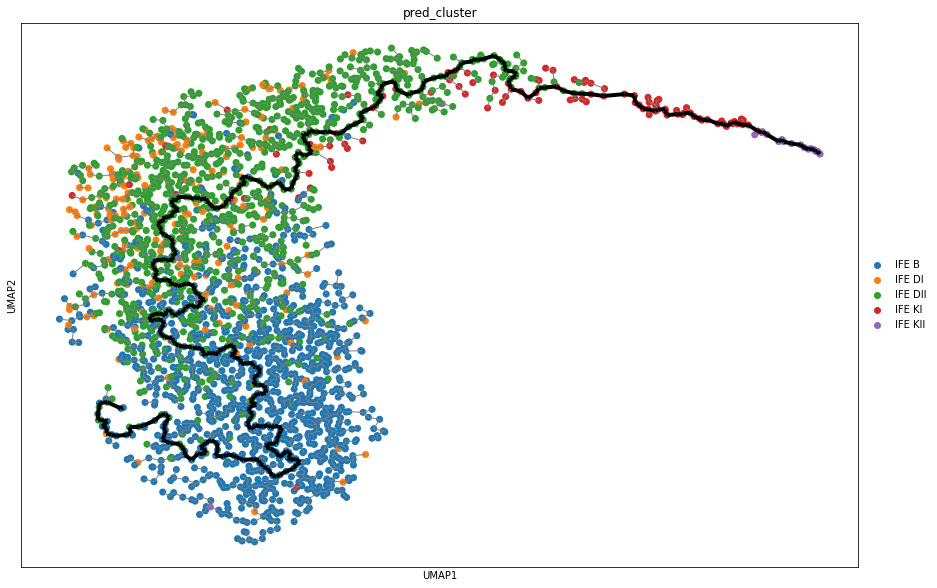

In [227]:
fig = plt.figure(figsize = (15,10))
ax1 = plt.subplot()
g = sc.pl.umap(data_magic, color = 'pred_cluster', show = False, ax = ax1, s = 200)
nx.draw_networkx_edges(MST, pos = MST_pos_umap, ax = g,
                       with_labels = True, node_size = 125, linewidths = 10.0, #These don't do anything? 
                       width = 1.0, edge_color = 'grey', 
                       vmin = 0, vmax = 1.0)

nx.draw_networkx_edges(MST, pos = MST_pos_umap, ax = g,
                       edgelist = diam_edges.edges(), width = 4,
                       edge_color = 'k')

# Checkpoint

# Continue 

## Downsample raw counts

In [86]:
path = 'X:/karlan/Seq data/Mouse skin/Greco/Katie/Output'
raw_data = sc.read_csv(os.path.join(path, '{}_raw_counts.csv'.format(raw_filename)))

In [87]:
raw_data.obs['batch'] = ['10x' if '10x' in x else 'Ivl' if 'Tomato' in x else 'C1' for x in raw_data.obs_names]
raw_data.X = np.expm1(raw_data.X)

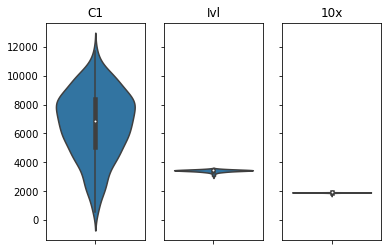

In [89]:
fig, axes= plt.subplots(ncols = 3, sharey = True)

batches = ['C1','Ivl','10x']
for ix, b in enumerate(batches):
    ax = axes[ix]
    sbn.violinplot(np.sum(raw_data[raw_data.obs['batch']==b].X, axis = 1), orient='v', ax = ax)
    ax.set_title(b)
    #ax.set_ylim([0,6000])

In [90]:
raw_c1 = raw_data[raw_data.obs['batch']=='C1']
raw_ivl = raw_data[raw_data.obs['batch']=='Ivl']
raw_10x = raw_data[raw_data.obs['batch']=='10x']

In [91]:
counts = 2000
raw_c1_ds = sc.pp.downsample_counts(raw_c1, counts_per_cell = counts, copy = True)
raw_ivl_ds = sc.pp.downsample_counts(raw_ivl, counts_per_cell = counts, copy = True)
raw_10x_ds = sc.pp.downsample_counts(raw_10x, counts_per_cell = counts, copy = True)

In [92]:
raw_data_ds = raw_c1_ds.concatenate(raw_ivl_ds, raw_10x_ds, batch_key = 'conc_batch', batch_categories = None, index_unique = None)

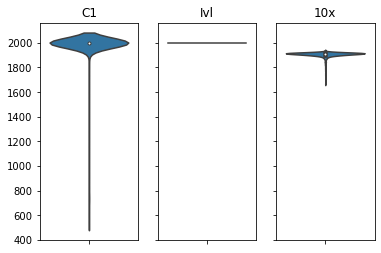

In [93]:
fig, axes= plt.subplots(ncols = 3, sharey = True)

batches = ['C1','Ivl','10x']
for ix, b in enumerate(batches):
    ax = axes[ix]
    sbn.violinplot(np.sum(raw_data_ds[raw_data_ds.obs['batch']==b].X, axis = 1), orient='v', ax = ax)
    ax.set_title(b)
    #ax.set_ylim([0,1000])

In [94]:
sc.pp.log1p(raw_data_ds)

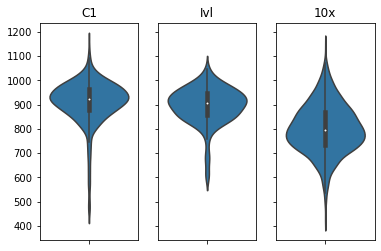

In [95]:
fig, axes= plt.subplots(ncols = 3, sharey = True)

batches = ['C1','Ivl','10x']
for ix, b in enumerate(batches):
    ax = axes[ix]
    sbn.violinplot(np.sum(raw_data_ds[raw_data_ds.obs['batch']==b].X, axis = 1), orient='v', ax = ax)
    ax.set_title(b)
    #ax.set_ylim([0,1000])

In [96]:
data_magic.raw = raw_data_ds

## Assign Basal/Suprabasal cutoff
Cutoff = PTO-coordinate that encompasses 95% of sorted basal cells

In [7]:
fig_path = 'X:/karlan/Seq data/Mouse skin/Greco/Katie/Figure_Output'

In [8]:
data_magic.obs['C1_pred_cluster'] = ['10x' if b=='10x' else clust for b, clust in data_magic.obs[['batch','pred_cluster']].values]
data_magic.obs['10x_leiden'] = ['C1' if b!='10x' else clust for b, clust in data_magic.obs[['batch','leiden']].values]

In [15]:
data_magic.uns['C1_pred_cluster_colors'] = ['#4c72b0', '#dd8452', '#55a868', '#c44e52', '#8172b3', '#cfcfcf']

In [402]:
data_magic.obs['Ivl_cells'] = ['Sorted basal' if 'Tomato' in x else 'Unsorted' for x in data_magic.obs_names]

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


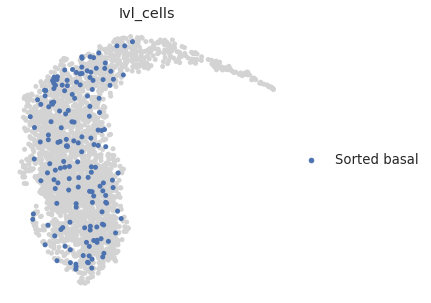

In [538]:
fig, ax = plt.subplots(1, figsize = (5,5))
sc.pl.umap(data_magic, color = 'Ivl_cells', ncols = 3, groups = 'Sorted basal', frameon = False, s = 100, show = False, ax = ax)
fig.savefig(os.path.join(fig_path, 'IFE_umap_Ivl-cells.pdf'.format(gene)), transparent = True, bbox_inches = 'tight')

In [423]:
data_magic.obs['pto_coords'] = 1-data_magic.obs['pto_coords'].div(data_magic.obs['pto_coords'].max())

In [18]:
B_SB_cutoff = np.percentile(data_magic[data_magic.obs['Ivl_cells']=='Sorted basal'].obs['pto_coords'].values, q = 95)

In [19]:
data_magic.obs['Location'] = ['Basal' if x<=B_SB_cutoff else 'Suprabasal' for x in data_magic.obs['pto_coords']]

... storing 'Location' as categorical
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have

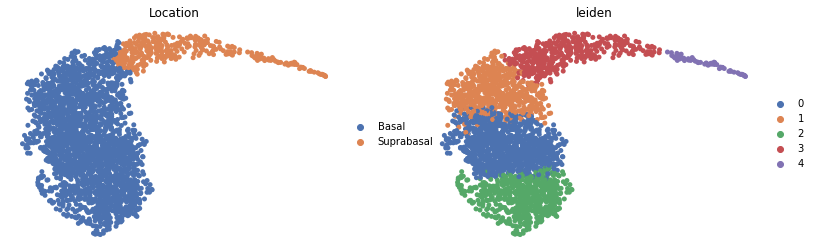

In [20]:
sc.pl.umap(data_magic, color = ['Location', 'leiden'], ncols = 3, frameon = False, s = 100, show = False)

In [677]:
iroot = np.where(data_magic.obs_names == data_magic.obs['pto_coords'].sort_values().index[-1])[0]
data_magic.uns['iroot'] = iroot[0]

In [692]:
sc.tl.diffmap(data_magic)

In [693]:
sc.tl.dpt(data_magic)

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\scanpy\plotting\_utils.py:284: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  if show: pl.show()


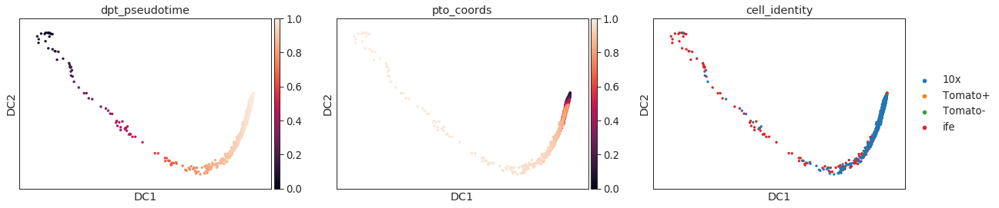

In [694]:
sc.pl.diffmap(data_magic, color = ['dpt_pseudotime', 'pto_coords', 'cell_identity'])

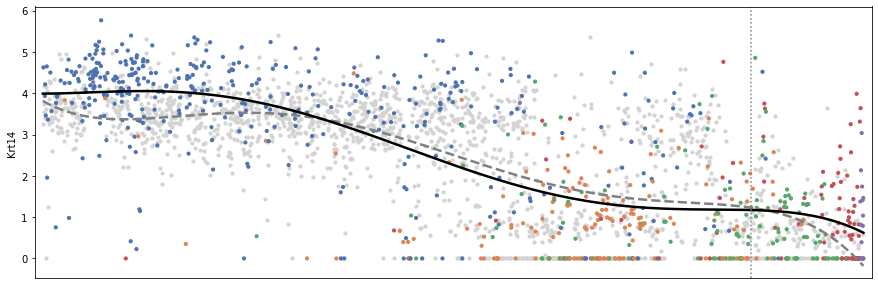

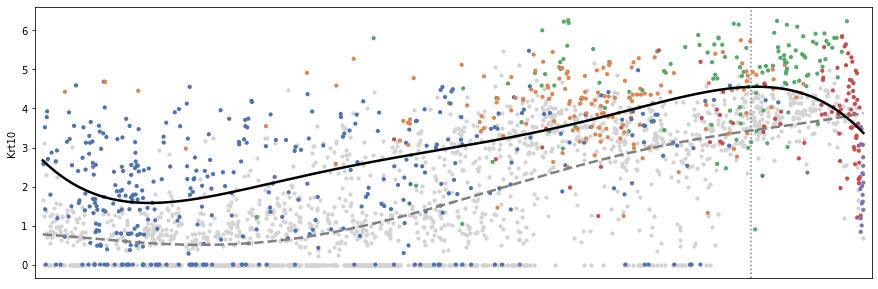

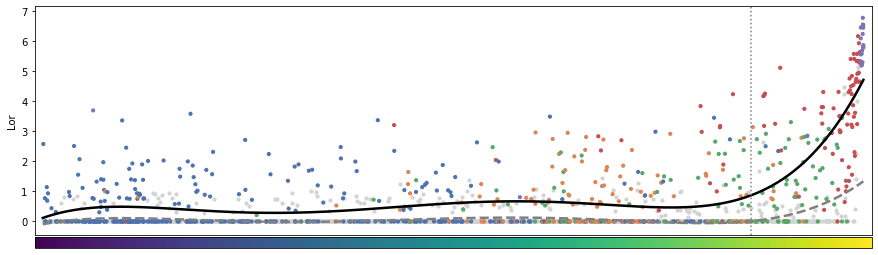

In [68]:
line_kwargs = {'c': 'k', 'ls': '-', 'lw': 2.5}
for gene in ['Krt14','Krt10','Lor']:
    ax = plot_pseudotime_gene_expression(data_magic[data_magic.obs['batch']=='10x'], gene, color = 'lightgray', pseudotime_col='pto_coords', use_raw=True,
                                cbar = False, legend = False,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, 
                                return_axis=True, plot_reg_expr_intercept=False, round_decimals=3, expr_cutoff=3, print_intercept=False,
                                **{'c': 'grey', 'ls': '--', 'lw': 2.5})
    plot_pseudotime_gene_expression(data_magic[data_magic.obs['batch']=='C1'], gene, color = 'pred_cluster', pseudotime_col='pto_coords', use_raw=True,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, ax = ax, legend = False,
                                cbar = True if gene == 'Lor' else False,
                                **line_kwargs, return_axis=False, plot_reg_expr_intercept=False, 
                                round_decimals=3, expr_cutoff=3, print_intercept=False)
    ax.axvline(B_SB_cutoff, c = 'grey', ls = ':')

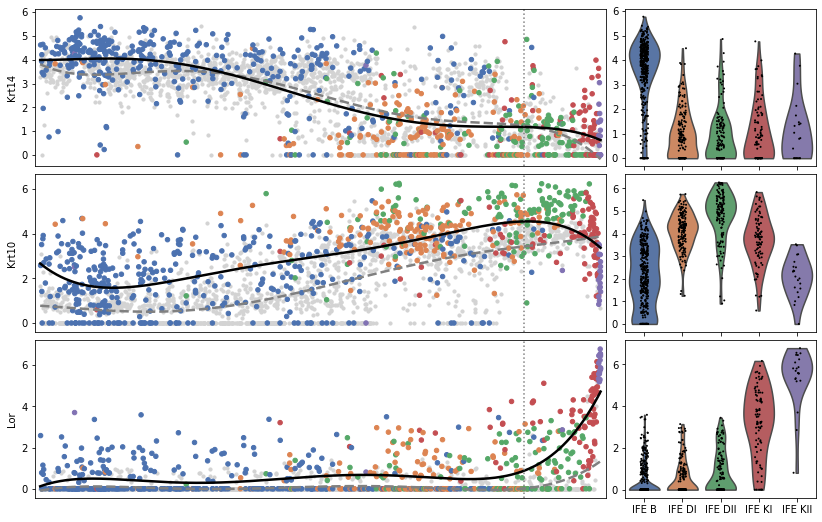

In [104]:
fig, axes = initialize_subplots(groups_to_plot=2*3, ncols = 2, figsize = (14, 9), print_help=False,
                                sharex = 'col', sharey = False, gridspec_kw={'wspace':0.05, 'hspace':0.05, 'width_ratios':[3,1]})

color = 'pred_cluster'
line_kwargs = {'c': 'k', 'ls': '-', 'lw': 2.5}
for row, gene in enumerate(['Krt14','Krt10','Lor']):
    ax = axes[row, 0]
    """plot_pseudotime_gene_expression(data_magic, gene, color = color, pseudotime_col='pto_coords', use_raw=True, 
                                ax = ax, cbar = False, legend=True if row == 0 else False,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, 
                                **line_kwargs, return_axis=True, plot_reg_expr_intercept=False, 
                                round_decimals=3, expr_cutoff=3, print_intercept=False)"""
    
    plot_pseudotime_gene_expression(data_magic[data_magic.obs['batch']=='10x'], gene, color = 'lightgray', pseudotime_col='pto_coords', use_raw=True,
                                cbar = False, legend = False, ax = ax,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, 
                                return_axis=True, plot_reg_expr_intercept=False, round_decimals=3, expr_cutoff=3, print_intercept=False,
                                **{'c': 'grey', 'ls': '--', 'lw': 2.5})
    plot_pseudotime_gene_expression(data_magic[data_magic.obs['batch']=='C1'], gene, color = color, pseudotime_col='pto_coords', use_raw=True,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, ax = ax, legend = False,
                                cbar = False if gene == 'Lor' else False, s = 20,
                                **line_kwargs, return_axis=False, plot_reg_expr_intercept=False, 
                                round_decimals=3, expr_cutoff=3, print_intercept=False)
    
    ax.axvline(B_SB_cutoff, c = 'grey', ls = ':')

    ax = axes[row, 1]
    sc.pl.violin(data_magic[data_magic.obs['batch']=='C1'], keys = gene, groupby = color, ax = ax, show = False, cut = 0, size = 2)
    ax.set_ylabel('')
    ax.set_xlabel('')

fig.savefig(os.path.join(fig_path, 'C1_IFE_gene-expression_over_pto_violin.pdf'), transparent = True, bbox_inches = 'tight')

In [95]:
def convert_rgb_to_hex(rgb = None, adata = None, color_name = None):
    if rgb:
        return ['#%02x%02x%02x' % (int(x*255)) for x in rgb]
    if adata:
        return ['#%02x%02x%02x' % (int(x[0]*255), int(x[1]*255), int(x[2]*255)) for x in adata.uns['{}_colors'.format(color_name)]]

In [100]:
convert_rgb_to_hex(adata = data_magic, color_name = 'leiden')

['#4c72b0', '#dd8452', '#55a868', '#c44e52', '#8172b3']

In [91]:
data_magic.uns['pred_cluster_colors'] = ['#%02x%02x%02x' % (int(x[0]*255), int(x[1]*255), int(x[2]*255)) for x in data_magic.uns['pred_cluster_colors']]

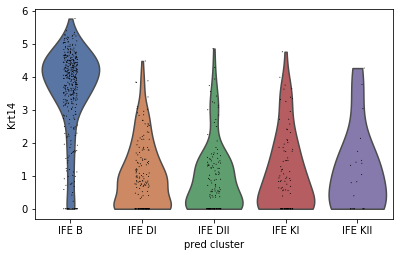

In [92]:
sc.pl.violin(data_magic[data_magic.obs['batch']=='C1'], keys = ['Krt14'], groupby = 'pred_cluster')

In [743]:
data_magic.obs['dpt_pseudotime_ordered'] = np.argsort(np.argsort(data_magic.obs['dpt_pseudotime'])).div(
    np.argsort(np.argsort(data_magic.obs['dpt_pseudotime'])).max())

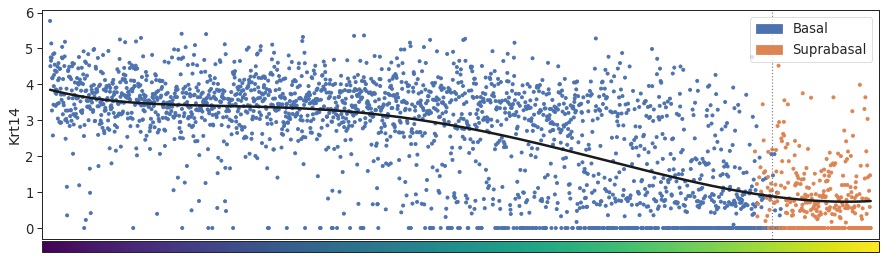

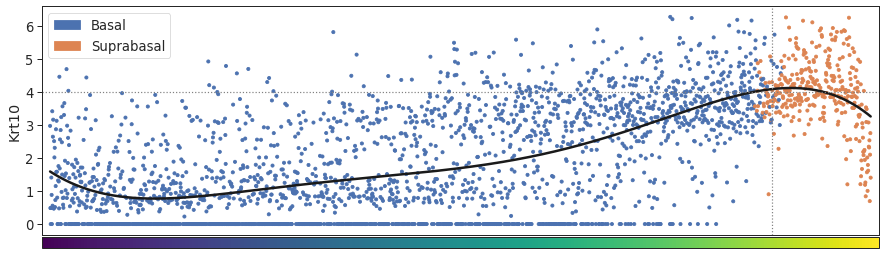

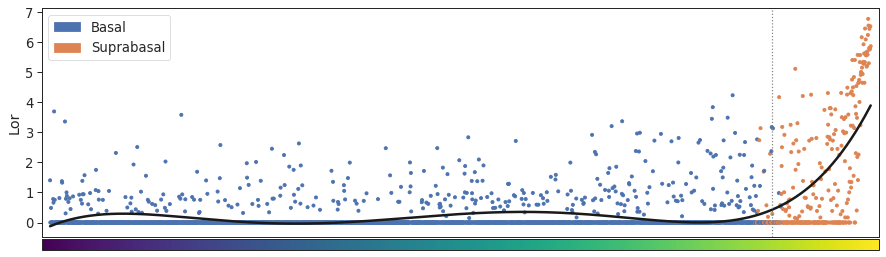

In [745]:
line_kwargs = {'c': 'k', 'ls': '-', 'lw': 2.5}
for gene in ['Krt14','Krt10','Lor']:
    ax = plot_pseudotime_gene_expression(data_magic, gene, color = 'Location', pseudotime_col='dpt_pseudotime_ordered', use_raw=True,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, 
                                **line_kwargs, return_axis=True, plot_reg_expr_intercept=False, 
                                round_decimals=3, expr_cutoff=3, print_intercept=True)
    if gene == 'Krt10':
        ax.axhline(4, c = 'grey', ls = ':')
    ax.axvline(0.8798, c = 'grey', ls = ':')

In [108]:
data_magic.obs['stage'] = ['Anagen' if '5w' in x else 'Telogen' for x in data_magic.obs_names]

# Cell cycle

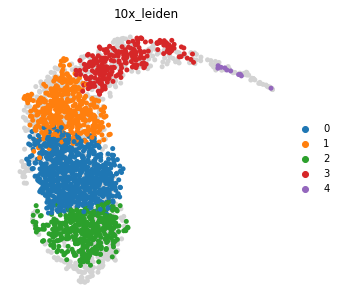

In [11]:
fig, ax = plt.subplots(1, figsize = (5,5))
sc.pl.umap(data_magic, color = ['10x_leiden'], ncols = 3, cmap = 'viridis', groups=['0', '1', '2', '3', '4'],
           s = 100, frameon = False, ax = ax, show = False)
#fig.savefig(os.path.join(fig_path, 'IFE_umap_10x_leiden.pdf'), transparent = True, bbox_inches = 'tight')

In [31]:
leiden_dict = {'0': 'IFE BII', '1': 'IFE DI', '2': 'IFE BI', '4': 'IFE K', '3': 'IFE DII'}

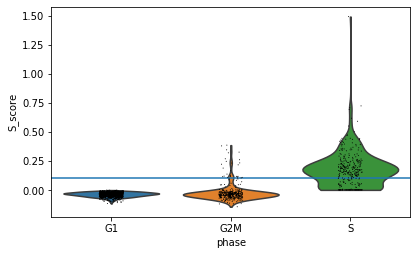

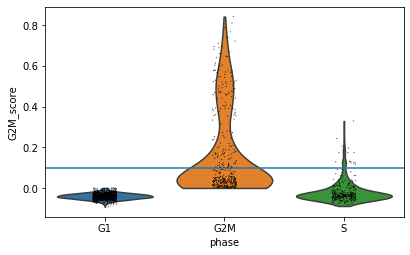

In [13]:
g = sc.pl.violin(data_magic[data_magic.obs['batch']=='10x'], keys='S_score', groupby = 'phase', show = False)
g.axhline(0.1)
g = sc.pl.violin(data_magic[data_magic.obs['batch']=='10x'], keys='G2M_score', groupby = 'phase', show = False)
g.axhline(0.1)

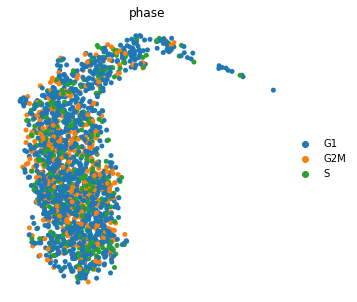

In [14]:
fig, ax = plt.subplots(1, figsize = (5,5))
sc.pl.umap(data_magic[data_magic.obs['batch']=='10x'], color = ['phase'], s = 100, frameon = False, ax = ax, show = False)
#fig.savefig(os.path.join(fig_path, 'IFE_umap_10x_leiden.pdf'), transparent = True, bbox_inches = 'tight')

Text(0, 0.5, 'G2M_score')

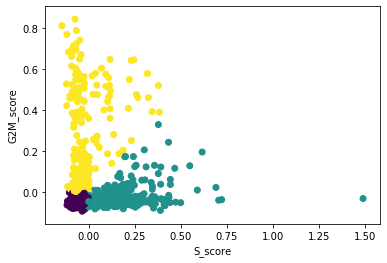

In [15]:
plt.scatter(x = data_magic[data_magic.obs['batch']=='10x'].obs['S_score'], y = data_magic[data_magic.obs['batch']=='10x'].obs['G2M_score'], 
            c = [0 if x == 'G1' else 1 if x == 'S' else 2 for x in data_magic[data_magic.obs['batch']=='10x'].obs['phase']])
plt.xlabel('S_score')
plt.ylabel('G2M_score')

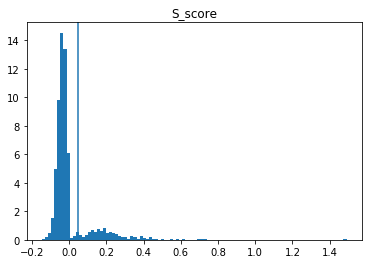

In [16]:
score = 'S_score'
plt.hist(x = data_magic[data_magic.obs['batch']=='10x'].obs[score], bins = 100, density = True)
plt.title(score)
plt.axvline(0.05)


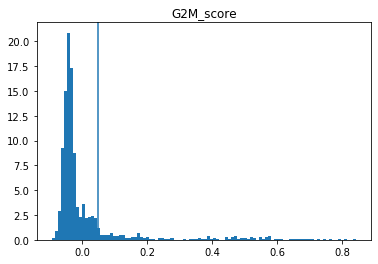

In [17]:
score = 'G2M_score'
plt.hist(x = data_magic[data_magic.obs['batch']=='10x'].obs[score], bins = 100, density = True)
plt.title(score)
plt.axvline(0.05)

In [18]:
reclassify_cell_cycle(data_magic, cutoff = 0.05)

Text(0, 0.5, 'G2M_score')

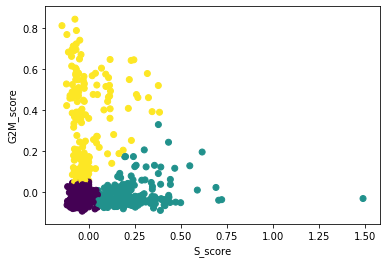

In [19]:
plt.scatter(x = data_magic[data_magic.obs['batch']=='10x'].obs['S_score'], y = data_magic[data_magic.obs['batch']=='10x'].obs['G2M_score'], 
            c = [0 if x == 'G1' else 1 if x == 'S' else 2 for x in data_magic[data_magic.obs['batch']=='10x'].obs['phase_c0.05']])
plt.xlabel('S_score')
plt.ylabel('G2M_score')

In [186]:
from collections import Counter

In [187]:
Counter(data_magic.obs['phase'])

Counter({'G1': 1872, 'G2M': 424, 'S': 350})

In [20]:
phase = 'phase'
data_magic.obs[phase].value_counts().div(data_magic.obs[phase].count())

G1     0.707483
G2M    0.160242
S      0.132275
Name: phase, dtype: float64

In [21]:
phase = 'phase_c0.05'
data_magic.obs[phase].value_counts().div(data_magic.obs[phase].count())

G1     0.747921
S      0.147392
G2M    0.104686
Name: phase_c0.05, dtype: float64

Trying to set attribute `.obs` of view, copying.
... storing 'Krt10 class' as categorical


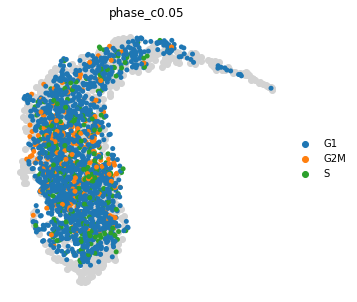

In [59]:
fig, ax = plt.subplots(1, figsize = (5,5))
tmp = data_magic[data_magic.obs['batch']!='10x'].obsm['X_umap']
ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')
sc.pl.umap(data_magic[data_magic.obs['batch']=='10x'], color = ['phase_c0.05'], s = 100, frameon = False, ax = ax, show = False)
fig.savefig(os.path.join(fig_path, 'IFE_umap_10x_cc.pdf'), transparent = True, bbox_inches = 'tight')

In [ ]:
fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap), ax=ax)

In [ ]:
a = np.array([[0,1]])
pl.figure(figsize=(9, 1.5))
img = pl.imshow(a, cmap="Blues")
pl.gca().set_visible(False)
cax = pl.axes([0.1, 0.2, 0.8, 0.6])
pl.colorbar(orientation="h", cax=cax)
pl.savefig("colorbar.pdf")

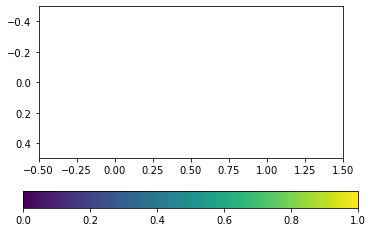

In [297]:
img = plt.imshow(np.array([[0,1]]), cmap="viridis")
img.set_visible(False)

plt.colorbar(orientation="horizontal")

In [300]:
data_magic.obs['batch'] = ['C1' if 'ife' in x else 'Ivl' if 'Tomato' in x else '10x' for x in data_magic.obs_names]

# Checkpoint

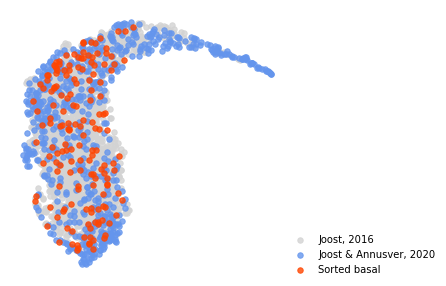

In [6]:
fig, ax = plt.subplots(figsize = (5,5))

cmap = ['lightgrey','cornflowerblue', 'orangered']
for ix, g in enumerate(['10x','C1','Ivl']):
    tmp = data_magic[data_magic.obs['batch']==g]
    ax.scatter(x = tmp.obsm['X_umap'][:, 0], y = tmp.obsm['X_umap'][:, 1], color = cmap[ix], s = 30, alpha = 0.8)
leg = plt.legend(labels = ['Joost, 2016', 'Joost & Annusver, 2020', 'Sorted basal'], frameon = False, loc = (1, 0))
for loc in ['right','top','left','bottom']:
    ax.spines[loc].set_visible(False)
for side in ['x','y']:
        ax.tick_params(
            axis=side,  # changes apply to the x-axis
            which='both',  # both major and minor ticks are affected
            bottom=False,  # ticks along the bottom edge are off
            top=False,  # ticks along the top edge are off
            left=False,
            labelbottom=False,
            labelleft=False,
            labeltop = False)
#fig.savefig(os.path.join(fig_path, 'IFE_datasets_colored_v2.pdf'), transparent = True, bbox_inches = 'tight')

# Checkpoint

# Plots for figures

In [5]:
data_magic

AnnData object with n_obs × n_vars = 2646 × 842 
    obs: '10x_leiden', 'Basa-Suprabasal', 'C1_pred_cluster', 'G2M_score', 'G2M_score_separate_original', 'Ivl_cells', 'Krt10 class', 'Krt10_group', 'Krt14_group', 'Location', 'S_score', 'S_score_separate_original', 'batch', 'cell_identity', 'clustering', 'dpt_pseudotime', 'layer', 'leiden', 'leiden_named', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_ERCC', 'log1p_total_counts_mito', 'n_genes', 'n_genes_by_counts', 'pct_counts_ERCC', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pct_counts_in_top_50_genes', 'pct_counts_mito', 'phase', 'phase_c0', 'phase_c0.05', 'phase_c0.1', 'phase_c0.2', 'phase_separate_original', 'pred_cluster', 'pto_coords', 'pto_coords_diffmap', 'total_counts', 'total_counts_ERCC', 'total_counts_mito', 'umap_density_C1_pred_cluster', 'umap_density_Ivl_cells', 'umap_density_Krt10 class', 'umap_density_batch', 'umap_density_cell_identity', 'umap_de

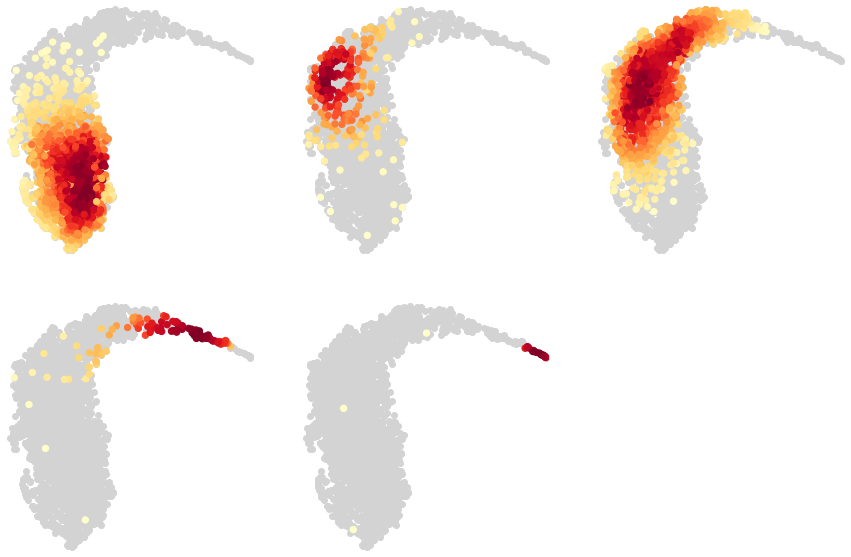

In [68]:
ncols = 3
nrows = 2
fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
for ix, cat in enumerate([x for x in data_magic.obs['pred_cluster'].cat.categories if x != '10x']):
    ax = axes[ix//ncols, ix%ncols]
    umap = data_magic.obsm['X_umap']
    
    tmp_values_pos = data_magic[data_magic.obs['pred_cluster']==cat].obs['umap_density_pred_cluster'].values
    tmp_umap_pos = data_magic[data_magic.obs['pred_cluster']==cat].obsm['X_umap']
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = [plt.cm.YlOrRd(x) for x in tmp_values_pos], s = 40)
    #ax.set_title(cat)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    clean_axis(ax)
    
clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

### Define line function for basal-suprabasal cutoff

In [7]:
from numpy import ones,vstack
from numpy.linalg import lstsq

Line Solution is y = -2.817173155586682x + 5.325081674268546


C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\ipykernel_launcher.py:12: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  if sys.path[0] == '':


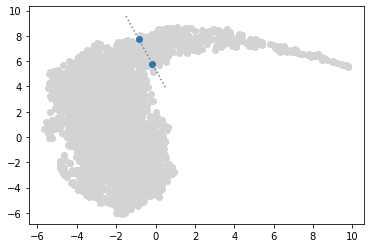

In [8]:
basal_cells = data_magic[(data_magic.obs['Location'] == 'Basal') & (data_magic.obs['Ivl_cells'] == 'Sorted basal')]
umap_coords = basal_cells[basal_cells.obs['pto_coords'].sort_values(ascending = False).index[:14]].obsm['X_umap']

x, y = zip(*data_magic.obsm['X_umap'])
plt.scatter(x, y, color = 'lightgrey')

x, y = zip(*umap_coords[[0,-1]])
plt.scatter(x,y)

x_coords, y_coords = zip(*umap_coords[[0,-1]])
A = vstack([x_coords,ones(len(x_coords))]).T
m, c = lstsq(A, y_coords)[0]
print("Line Solution is y = {m}x + {c}".format(m=m,c=c))

x0 = -1.5
x1 = 0.5

plt.plot([x0,x1], [m*x0+c, m*x1+c], ls = ':', c = 'grey')

In [10]:
def plot_basal_suprabasal_cutoff(ax, x0 = -1.5, x1 = 0.5, m = -2.817173155586682, c = 5.325081674268546, ls = '--', color = 'dimgrey', lw = 2): 
    ax.plot([x0,x1], [m*x0+c, m*x1+c], ls = ls, c = color, lw = lw)

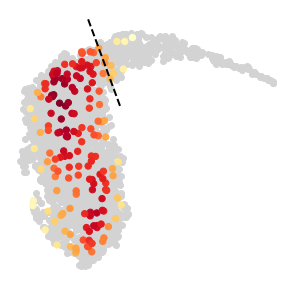

In [11]:
tmp_values_pos = data_magic[data_magic.obs['Ivl_cells']=='Sorted basal'].obs['umap_density_Ivl_cells'].values
tmp_umap_pos = data_magic[data_magic.obs['Ivl_cells']=='Sorted basal'].obsm['X_umap']
tmp_umap_neg = data_magic[data_magic.obs['Ivl_cells']!='Sorted basal'].obsm['X_umap']

fig, ax = plt.subplots(1, figsize = (5,5))
ax.scatter(x = tmp_umap_neg[:, 0], y = tmp_umap_neg[:, 1], color = 'lightgrey')
ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = [plt.cm.YlOrRd(x) for x in tmp_values_pos], s = 40)
plot_basal_suprabasal_cutoff(ax, color = 'k')
clean_axis(ax)

#plt.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_Ivl-cells_scatter_cutoffLine.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

### Marker gene expression

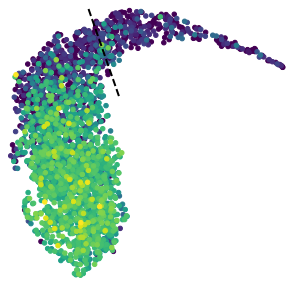

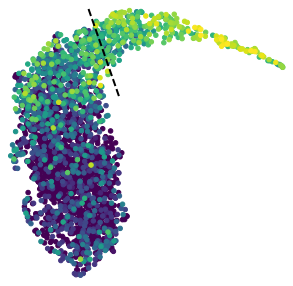

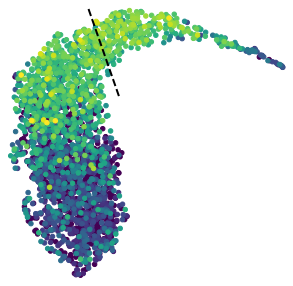

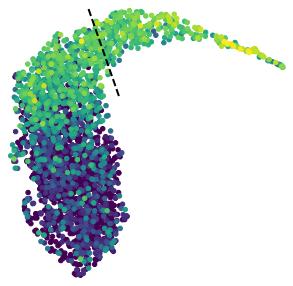

In [12]:
percentile = 99.9
add_perc = 0.2
for gene in ['Krt14','Sbsn', 'Krt10','Krtdap']:
    fig, ax = plt.subplots(figsize = (5,5))
    
    vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)
    umap = data_magic.obsm['X_umap']
    expression = data_magic.raw.X[:,np.where(data_magic.raw.var_names == gene)[0]]
    
    expression = expression.flatten()
    rank = np.argsort(expression)
    expression = np.array(expression)[rank]
    umap = np.array(umap)[rank]
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    plot_basal_suprabasal_cutoff(ax, color = 'k')
    clean_axis(ax)
    
    #plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_downsampled_wider_cutoffLine_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

### Dataset locations

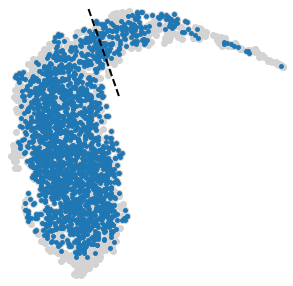

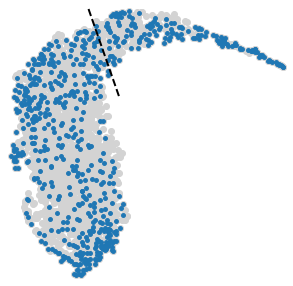

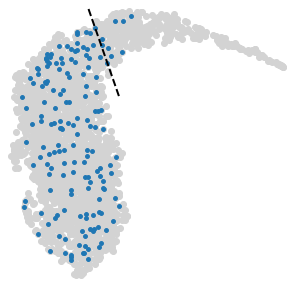

In [13]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
categories = ['10x', 'C1', 'Ivl']
grouping = 'batch'
for ix, cat in enumerate(categories):
    fig, ax = plt.subplots(figsize = (5,5))
                           
    umap = data_magic.obsm['X_umap']
    
    
    
    #tmp_values_pos = data_magic[data_magic.obs[grouping]==cat].obs['umap_density_{}'.format(grouping)].values
    tmp_umap_pos = data_magic[data_magic.obs[grouping]==cat].obsm['X_umap']
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = '#1f77b4', s = 15)
    #ax.set_title(cat)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    plot_basal_suprabasal_cutoff(ax = ax, ls = '--', color = 'black', lw = 2)
    
    clean_axis(ax)
    
    #fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_batch_{}_wider_single_color_cutoffLine.png'.format(cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
#clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

## Use kNN classifier to cluster all cell acording to reference Joost 2016

In [15]:
from sklearn.neighbors import KNeighborsClassifier
import sklearn.neighbors as skn
import sklearn

In [16]:
tmp_c1 = data_magic[data_magic.obs['batch']=='C1',:]
tmp_10x = data_magic[data_magic.obs['batch']=='10x',:]
tmp_ivl = data_magic[data_magic.obs['batch']=='Ivl',:]

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

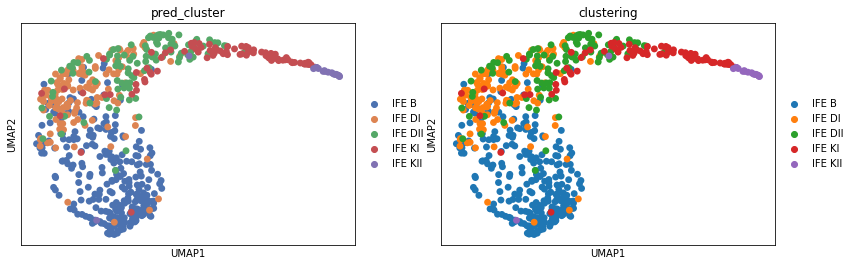

In [20]:
sc.pl.umap(tmp_c1, color = ['pred_cluster', 'clustering'])

In [21]:
cluster_dict = {'IFE KI': 3, 'IFE DII': 2, 'IFE B': 0, 'IFE KII': 4, 'IFE DI': 1}
cluster_dict_transposed = {val: key for key, val in cluster_dict.items()}
cluster_encoded = [cluster_dict[x] for x in tmp_c1.obs['clustering']]

In [22]:
neigh = KNeighborsClassifier(n_neighbors=20, weights='distance')
neigh.fit(tmp_c1.raw.X, cluster_encoded)
prediction = neigh.predict(tmp_10x.raw.X)
#print(prediction)

neigh_imp = KNeighborsClassifier(n_neighbors=20, weights='distance')
neigh_imp.fit(tmp_c1.X, cluster_encoded)
prediction_imp = neigh_imp.predict(tmp_10x.X)
#print(prediction)

In [ ]:
tmp_10x.obs['pred_cluster_ds'] = [cluster_dict_transposed[x] for x in prediction]
tmp_10x.obs['pred_cluster_imp'] = [cluster_dict_transposed[x] for x in prediction_imp]

In [24]:
prediction = neigh.predict(tmp_ivl.raw.X)

prediction_imp = neigh_imp.predict(tmp_ivl.X)

... storing 'pred_cluster_ds' as categorical
... storing 'pred_cluster_imp' as categorical
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequenc

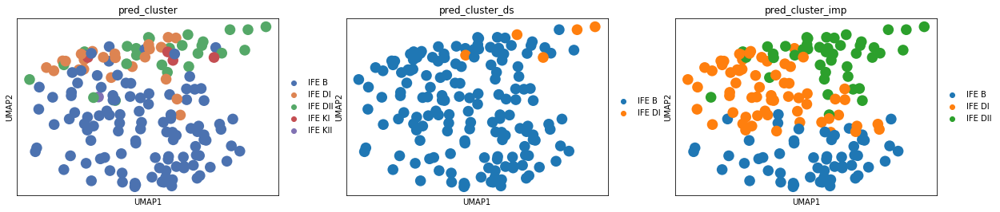

In [33]:
tmp_ivl.obs['pred_cluster_ds'] = [cluster_dict_transposed[x] for x in prediction]
tmp_ivl.obs['pred_cluster_imp'] = [cluster_dict_transposed[x] for x in prediction_imp]
sc.pl.umap(tmp_ivl, color = ['pred_cluster','pred_cluster_ds', 'pred_cluster_imp'])

In [26]:
cluster = 'pred_cluster_ds'
data_magic.obs[cluster] = [tmp_10x.obs[cluster].loc[cell] if '10x' in cell else tmp_ivl.obs[cluster].loc[cell] if 'Tomato' in cell else tmp_c1.obs['clustering'].loc[cell] for cell in data_magic.obs_names]
cluster = 'pred_cluster_imp'
data_magic.obs[cluster] = [tmp_10x.obs[cluster].loc[cell] if '10x' in cell else tmp_ivl.obs[cluster].loc[cell] if 'Tomato' in cell else tmp_c1.obs['clustering'].loc[cell] for cell in data_magic.obs_names]

### Results of clustering

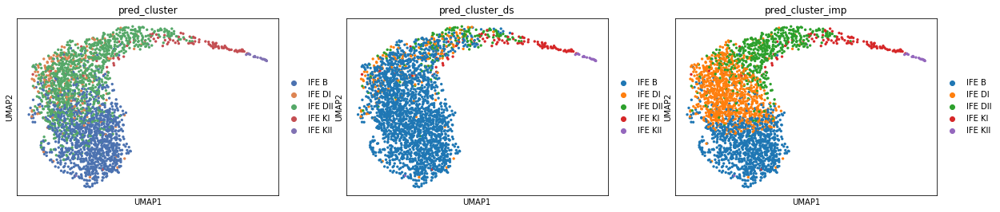

In [32]:
sc.pl.umap(data_magic, color = ['pred_cluster','pred_cluster_ds', 'pred_cluster_imp'])

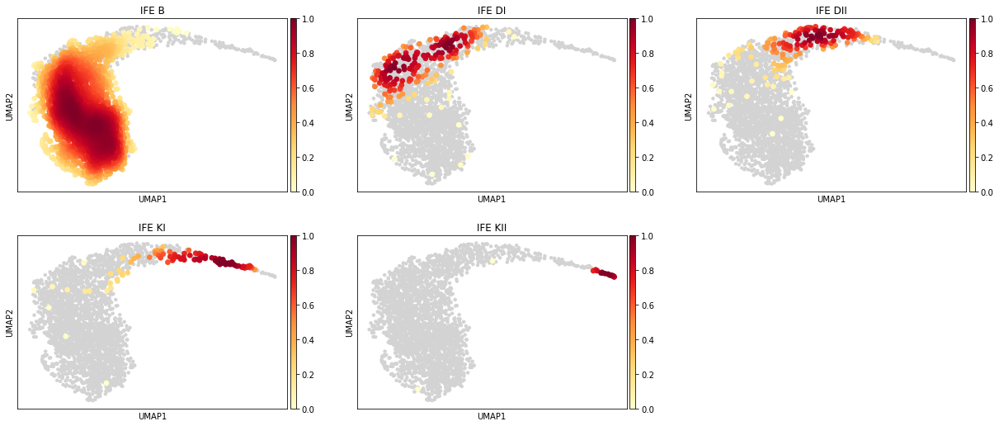

In [28]:
sc.tl.embedding_density(data_magic, groupby = 'pred_cluster_ds')
sc.pl.embedding_density(data_magic, groupby = 'pred_cluster_ds', ncols = 3)

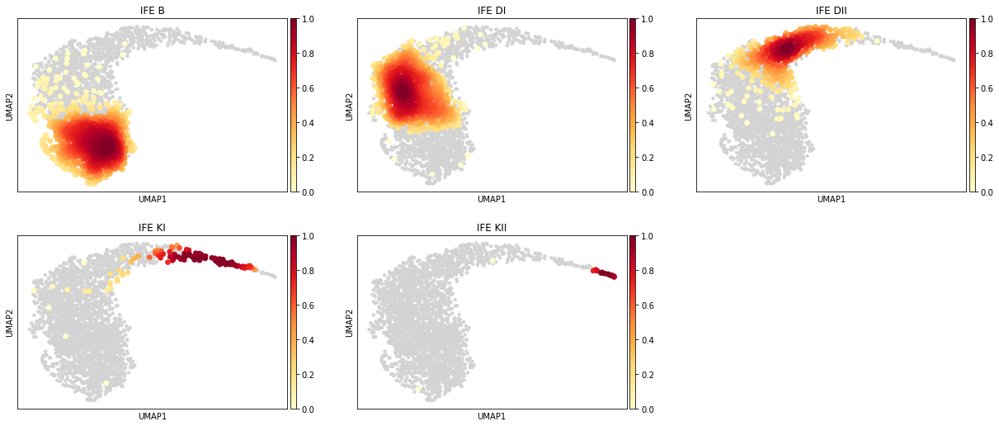

In [29]:
sc.tl.embedding_density(data_magic, groupby = 'pred_cluster_imp')
sc.pl.embedding_density(data_magic, groupby = 'pred_cluster_imp', ncols = 3)

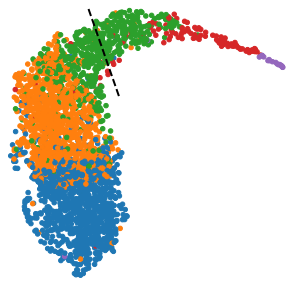

In [70]:
fig, ax = plt.subplots(figsize = (5,5))
grouping = 'pred_cluster_imp'
data_magic.uns['pred_cluster_imp_colors'] = convert_rgb_to_hex(rgb = sbn.color_palette(palette = 'tab10', n_colors = 5))
cmap = dict(zip(data_magic.obs[grouping].cat.categories, data_magic.uns['{}_colors'.format(grouping)]))

umap = data_magic.obsm['X_umap']
ax.scatter(x = umap[:, 0], y = umap[:, 1], color = [cmap[x] for x in data_magic.obs[grouping]], s = 20)

add_perc = 0.2
ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])

plot_basal_suprabasal_cutoff(ax = ax, ls = '--', color = 'black', lw = 2)
clean_axis(ax)

#fig.savefig(os.path.join(fig_path, 'IFE_umap_clustering_{}_wider.png'.format(grouping)),
#            transparent = True, bbox_inches = 'tight', dpi = 600)

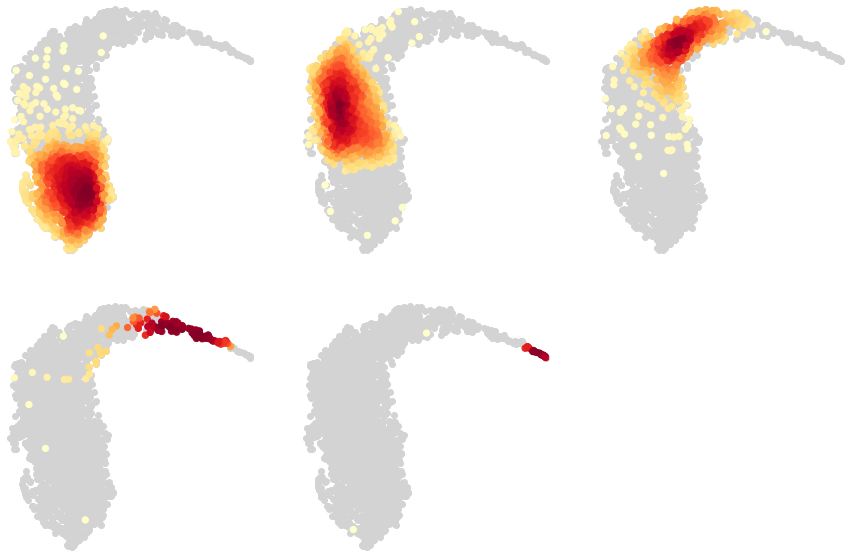

In [31]:
ncols = 3
nrows = 2
fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
for ix, cat in enumerate([x for x in data_magic.obs['pred_cluster_imp'].cat.categories if x != '10x']):
    ax = axes[ix//ncols, ix%ncols]
    umap = data_magic.obsm['X_umap']
    
    tmp_values_pos = data_magic[data_magic.obs['pred_cluster_imp']==cat].obs['umap_density_pred_cluster_imp'].values
    tmp_umap_pos = data_magic[data_magic.obs['pred_cluster_imp']==cat].obsm['X_umap']
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = [plt.cm.YlOrRd(x) for x in tmp_values_pos], s = 40)
    #ax.set_title(cat)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    clean_axis(ax)
    
clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_imputated_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

#### Dataset contribution to clusters

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\pandas\plotting\_matplotlib\core.py:203: UserWarning: 'colors' is being deprecated. Please use 'color'instead of 'colors'
  "'colors' is being deprecated. Please use 'color'"


(0, 100)

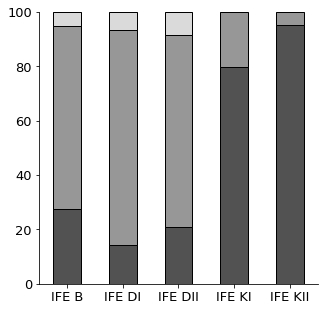

In [55]:
fig, ax = plt.subplots(figsize = (5,5))

group1 = 'pred_cluster_imp'
group2 = 'batch'

#df = (data_magic.obs.groupby(group1)[group2].value_counts().div(data_magic.obs.groupby(group1)[group2].count())*100).reset_index(name='Percentage')
"""sbn.barplot(data = df, y = 'Percentage', x = group1, hue = group2, palette = 'Greys', ax = ax, 
            hue_order = ['C1','10x','Ivl'])
"""
df = (data_magic.obs.groupby(group1)[group2].value_counts().div(data_magic.obs.groupby(group1)[group2].count())*100).reset_index(name='Percentage').reset_index().pivot(columns=group2, index=group1, values='Percentage').fillna(0)
df[['C1','10x','Ivl']].plot(kind = 'bar', stacked = True, colors = sbn.color_palette(palette = 'Greys_r', n_colors=3), ax = ax, legend = False,
                           fontsize = 13, edgecolor = 'k')

ax.set_ylabel('')
ax.set_xlabel('')
ax.set_xticklabels(labels = ax.get_xticklabels(), rotation = 0)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.set_ylim([0,100])
#fig.savefig(os.path.join(fig_path, 'IFE_Barplot_Clustering_percentage_in_Batch_stacked.pdf'), transparent = True, bbox_inches = 'tight', dpi = 600)

## Classify cells according to Krt10 expression

In [43]:
krt10_expr = data_magic.raw[:, np.where(data_magic.raw.var_names=='Krt10')[0][0]].X.flatten()

In [44]:
krt10_basal = krt10_expr[np.where(data_magic.obs['pred_cluster_imp']=='IFE B')[0]]

Text(2, 0.5, 'mean: 1.84')

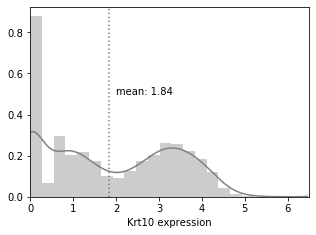

In [45]:
fig, g = plt.subplots(figsize = (5,3.5))
sbn.distplot(krt10_expr, bins = 20, ax = g, color = 'grey')
g.axvline(np.mean(krt10_expr), c = 'grey', ls = ':')
#g.axvline(np.median(krt10_expr), c = 'r')
g.set_xlim([0,6.5])
g.set_xlabel('Krt10 expression')
g.text(x = 2, y = 0.5, s = 'mean: {:.2f}'.format(np.mean(krt10_expr)))
#plt.savefig(os.path.join(fig_path, 'IFE_Krt10_expression_distribution.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

Text(0.5, 0, 'Krt10 expression')

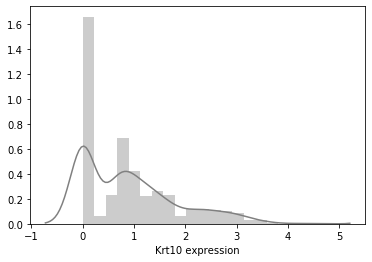

In [46]:
g = sbn.distplot(krt10_basal, bins = 20, color = 'grey')
#g.axvline(np.mean(krt10_basal), c = 'grey')
#g.axvline(np.median(krt10_expr), c = 'r')
#g.set_xlim([0,6.5])
g.set_xlabel('Krt10 expression')
#g.text(x = 2, y = 0.5, s = 'mean: {}'.format(np.mean(krt10_expr)))

In [47]:
data_magic.obs['Krt10_class_mean'] = np.where(krt10_expr>np.mean(krt10_expr), 'Krt10+', 'Krt10-')

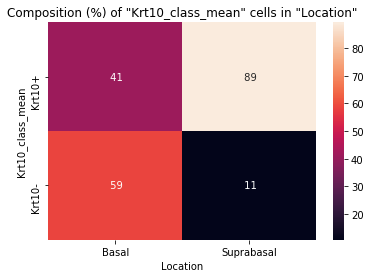

In [48]:
plot_group_composition_heatmap(data_magic.obs, groupby_name = 'Location', count_group_name='Krt10_class_mean', transpose = True)

... storing 'Krt10_class_mean' as categorical


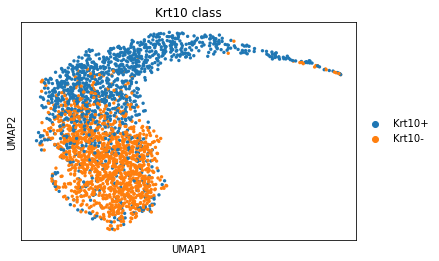

In [50]:
sc.pl.umap(data_magic, color = 'Krt10 class')

#### Density estimate

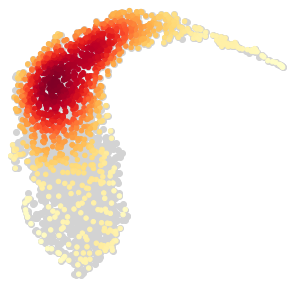

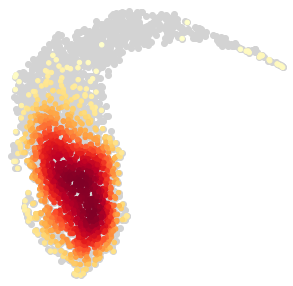

In [53]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
#categories = ['10x', 'C1', 'Ivl']
grouping = 'Krt10 class'
for ix, cat in enumerate([x for x in data_magic.obs[grouping].cat.categories]):
    fig, ax = plt.subplots(figsize = (5,5))
                           
    umap = data_magic.obsm['X_umap']
    
    tmp_values_pos = data_magic[data_magic.obs[grouping]==cat].obs['umap_density_{}'.format(grouping)].values
    tmp_umap_pos = data_magic[data_magic.obs[grouping]==cat].obsm['X_umap']
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = [plt.cm.YlOrRd(x) for x in tmp_values_pos], s = 20)
    #ax.set_title(cat)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    clean_axis(ax)
    
    #fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_{}_{}_wider.png'.format(grouping, cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
#clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

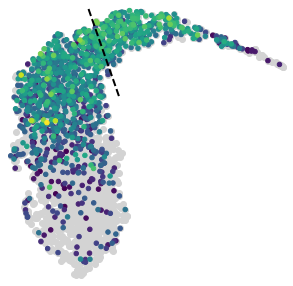

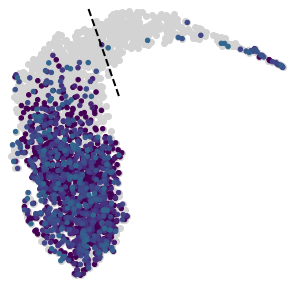

In [52]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
#categories = ['10x', 'C1', 'Ivl']
grouping = 'Krt10_class_mean'
vmax = krt10_expr.max()
for ix, cat in enumerate([x for x in data_magic.obs[grouping].cat.categories]):
    fig, ax = plt.subplots(figsize = (5,5))
                           
    umap = data_magic.obsm['X_umap']
    
    tmp_pos = data_magic[data_magic.obs[grouping]==cat]
    
    tmp_values_pos = tmp_pos.raw[:, np.where(tmp_pos.raw.var_names=='Krt10')[0][0]].X.flatten()
    tmp_umap_pos = tmp_pos.obsm['X_umap']
    
    rank = np.argsort(tmp_values_pos)
    tmp_values_pos = np.array(tmp_values_pos)[rank]
    tmp_umap_pos = np.array(tmp_umap_pos)[rank]

    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], c = tmp_values_pos, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    plot_basal_suprabasal_cutoff(ax = ax, ls = '--', color = 'black', lw = 2)
    clean_axis(ax)
    
    #fig.savefig(os.path.join(fig_path, 'IFE_umap_expression_{}_{}_wider.png'.format(grouping, cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
#clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

#### Quantify basal K10

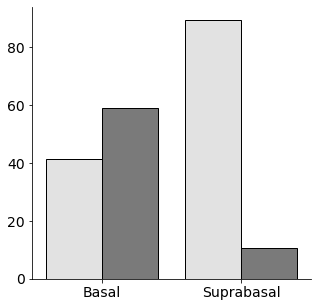

In [54]:
palette = sbn.color_palette(palette = 'Greys', n_colors = 4)

fig, ax = plt.subplots(figsize = (5,5))

df = (data_magic.obs.groupby('Location')['Krt10_class_mean'].value_counts().div(data_magic.obs.groupby('Location')['Krt10_class_mean'].count())*100).reset_index(name='Percentage')
sbn.barplot(data = df, y = 'Percentage', x = 'Location', hue = 'Krt10_class_mean', hue_order = ['Krt10+','Krt10-'], 
            palette = [palette[0], palette[-2]], ax = ax, edgecolor = 'k')
ax.set_ylabel('')
ax.set_xlabel('')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.tick_params(axis="y", labelsize=14)
ax.tick_params(axis="x", labelsize=14)

ax.legend(handles = [], frameon = False)

#fig.savefig(os.path.join(fig_path, 'IFE_Barplot_Krt10_percentage_mean.pdf'.format(grouping, cat)), transparent = True, bbox_inches = 'tight', dpi = 600)

## Assign cell age

In [56]:
data_magic.obs['age'] = ['9w' if '9w' in name else '5w' if '5w' in name else '9w' for name in data_magic.obs_names]

... storing 'age' as categorical


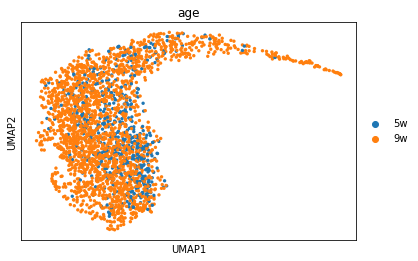

In [57]:
sc.pl.umap(data_magic, color = 'age')

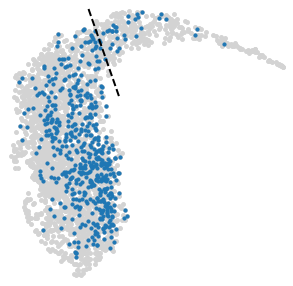

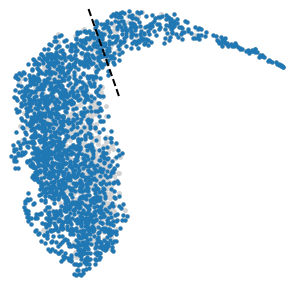

In [59]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
categories = ['5w', '9w']
grouping = 'age'
for ix, cat in enumerate(categories):
    fig, ax = plt.subplots(figsize = (5,5))
                           
    umap = data_magic.obsm['X_umap']
    
    tmp_umap_pos = data_magic[data_magic.obs[grouping]==cat].obsm['X_umap']
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey', s = 15)
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = '#1f77b4', s = 10)
    #ax.set_title(cat)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    plot_basal_suprabasal_cutoff(ax = ax, ls = '--', color = 'black', lw = 2)
    clean_axis(ax)
    
    #fig.savefig(os.path.join(fig_path, 'IFE_umap_Hair_Cycle_{}_wider.png'.format(cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
#clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

## Plot cell cycle

#### All datasets together

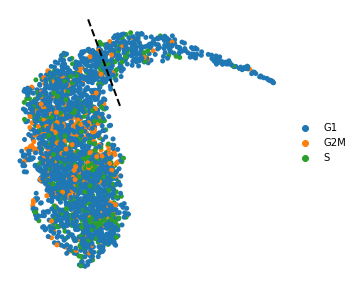

In [60]:
fig, ax = plt.subplots(1, figsize = (5,5))
#tmp = data_magic[data_magic.obs['batch']!='10x'].obsm['X_umap']
#ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')
sc.pl.umap(data_magic, color = ['phase_c0.05'], s = 100, frameon = False, ax = ax, show = False, title = '')
plot_basal_suprabasal_cutoff(ax, color = 'k')
#fig.savefig(os.path.join(fig_path, 'IFE_umap_cell_cycle.png'), transparent = True, bbox_inches = 'tight')

#### Only Joost 2020 dataset

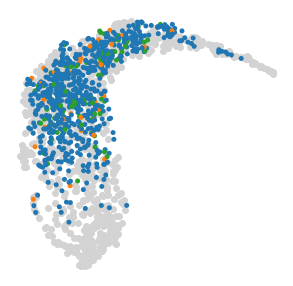

In [61]:
fig, ax = plt.subplots(1, figsize = (5,5))
tmp = data_magic[data_magic.obs['batch']!='10x'].obsm['X_umap']
ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')
sc.pl.umap(data_magic[(data_magic.obs['batch']=='10x') & (data_magic.obs['Krt10_class_mean']=='Krt10+')], 
           color = ['phase_c0.05'], s = 100, frameon = False, ax = ax, show = False, legend_loc = False, title = '')
#fig.savefig(os.path.join(fig_path, 'IFE_umap_10x_Krt10-pos_cc.pdf'), transparent = True, bbox_inches = 'tight')

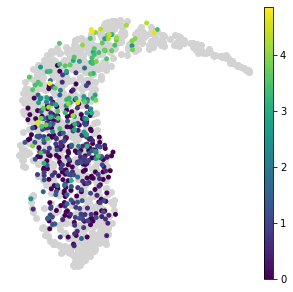

In [62]:
fig, ax = plt.subplots(1, figsize = (5,5))
tmp = data_magic[data_magic.obs['batch']!='10x'].obsm['X_umap']
ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')
sc.pl.umap(data_magic[(data_magic.obs['batch']=='10x') & (data_magic.obs['phase_c0.05'].isin(['G2M','S']))], 
           color = ['Krt10'], s = 100, frameon = False, ax = ax, show = False, title = '')
#fig.savefig(os.path.join(fig_path, 'IFE_umap_10x_Krt10_expression_in_cycling_cells.pdf'), transparent = True, bbox_inches = 'tight')

#### Replicates in Joost 2020 dataset

In [74]:
replicates = pd.read_csv(os.path.join('X:/karlan/Seq data/Mouse skin/Anagen_10x/2019 data/data_input/v1.4', '201806201840_assigned_barcodes.txt'), sep = '\t', index_col = None, header = None)

replicates = replicates.drop_duplicates(subset = 0).set_index(0)
replicates.index = replicates.index.str[:14]

tmp10x = data_magic[data_magic.obs['batch'] == '10x']
tmp10x.obs['replicates'] = replicates.loc[tmp10x.obs_names.str[:14]].values.flatten()
tmp10x = tmp10x[tmp10x.obs['replicates']!='unassigned']

Trying to set attribute `.obs` of view, copying.


C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\anndata\_core\anndata.py:1172: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'replicates' as categorical


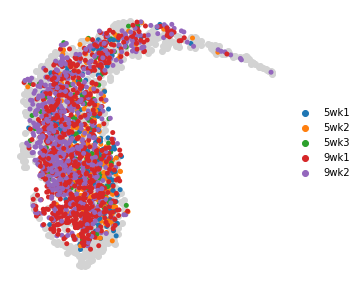

In [75]:
fig, ax = plt.subplots(1, figsize = (5,5))
tmp = data_magic[data_magic.obs['batch']!='10x'].obsm['X_umap']
ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')
sc.pl.umap(tmp10x, color = ['replicates'], s = 100, frameon = False, ax = ax, show = False, title = '')
#fig.savefig(os.path.join(fig_path, 'IFE_umap_10x_replicates.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [76]:
phases = ['G1','S','G2M']
rep_df = pd.DataFrame(columns = phases, index = tmp10x.obs['replicates'].cat.categories)
tmp = tmp10x[tmp10x.obs['Krt10 class']=='Krt10+']
for rep in tmp10x.obs['replicates'].cat.categories:
    rep_df.loc[rep] = tmp[tmp.obs['replicates']==rep].obs['phase_c0.05'].value_counts(normalize = True).loc[phases]

In [77]:
rep_df = rep_df.stack().reset_index()
rep_df = rep_df.rename(columns = {'level_0':'Replicate','level_1':'Phase',0:'Percentage'})
rep_df = rep_df.set_index('Replicate')
rep_df['stage'] = ['Telogen' if '9wk' in x else 'Anagen' for x in rep_df.index]

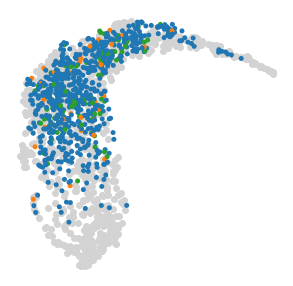

In [78]:
fig, ax = plt.subplots(1, figsize = (5,5))
tmp = data_magic[data_magic.obs['batch']!='10x'].obsm['X_umap']
ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')
sc.pl.umap(data_magic[(data_magic.obs['batch']=='10x') & (data_magic.obs['Krt10_class_mean']=='Krt10+')], 
           color = ['phase_c0.05'], s = 100, frameon = False, ax = ax, show = False, legend_loc = False, title = '')
#fig.savefig(os.path.join(fig_path, 'IFE_umap_10x_Krt10-pos_cc.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

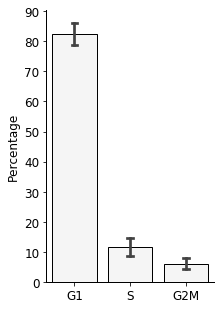

In [79]:
fig, ax = plt.subplots(1, figsize = (3,5))
sbn.barplot(data = rep_df, x = 'Phase', y = 'Percentage', color = 'whitesmoke', ax = ax, edgecolor = 'k', capsize = 0.1)
ax.set_yticks(np.arange(0,0.91, 0.10))
ax.set_yticklabels(np.arange(0,91, 10))

ax.set_xlabel('')
ax.set_xticklabels(['G1','S','G2M'],fontsize=12)
ax.set_ylabel('Percentage',fontsize=12)
ax.tick_params(labelsize=12)

for loc in ['right','top']:
    ax.spines[loc].set_visible(False)
    
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_linewidth(1)


#fig.savefig(os.path.join(fig_path, 'IFE_Krt10_cc_percentages.pdf'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [80]:
k10_stat = ['Krt10+', 'Krt10-']
rep_df = pd.DataFrame(columns = k10_stat, index = tmp10x.obs['replicates'].cat.categories)
tmp = tmp10x[tmp10x.obs['phase_c0.05'].isin(['G2M', 'S'])]
for rep in tmp10x.obs['replicates'].cat.categories:
    rep_df.loc[rep] = tmp[tmp.obs['replicates']==rep].obs['Krt10_class_mean'].value_counts(normalize = True).loc[k10_stat]

In [81]:
rep_df = rep_df.stack().reset_index()
rep_df = rep_df.rename(columns = {'level_0':'Replicate','level_1':'Krt10_class_mean',0:'Percentage'})
rep_df = rep_df.set_index('Replicate')
rep_df['stage'] = ['Telogen' if '9wk' in x else 'Anagen' for x in rep_df.index]

In [84]:
rep_df[rep_df['Krt10_class_mean']=='Krt10+']['Percentage']

Replicate
5wk1    0.267606
5wk2    0.215385
5wk3    0.216216
9wk1     0.28125
9wk2    0.243478
Name: Percentage, dtype: object

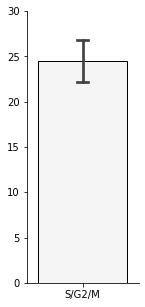

In [83]:
fig, ax = plt.subplots(1, figsize = (2,5))
sbn.barplot(data = rep_df, x = 'Krt10_class_mean', y = 'Percentage', color = 'whitesmoke', ax = ax, order = ['Krt10+'], capsize=0.1, edgecolor = 'k')
ax.set_yticks(np.arange(0,0.31, 0.05))
ax.set_yticklabels(np.arange(0,31,5))
ax.set_xlabel('')
ax.set_xticklabels(['S/G2/M'])
ax.set_ylabel('')

for loc in ['right','top']:
    ax.spines[loc].set_visible(False)
#fig.savefig(os.path.join(fig_path, 'IFE_Krt10_percentages_in_cycling_cells.pdf'), transparent = True, bbox_inches = 'tight', dpi = 600)

## Plot gene expression violinplots and UMAPs

In [65]:
n_colors = 8
colors = sbn.color_palette(palette = 'Greys', n_colors = n_colors)[1:]

ax = axes[ix]


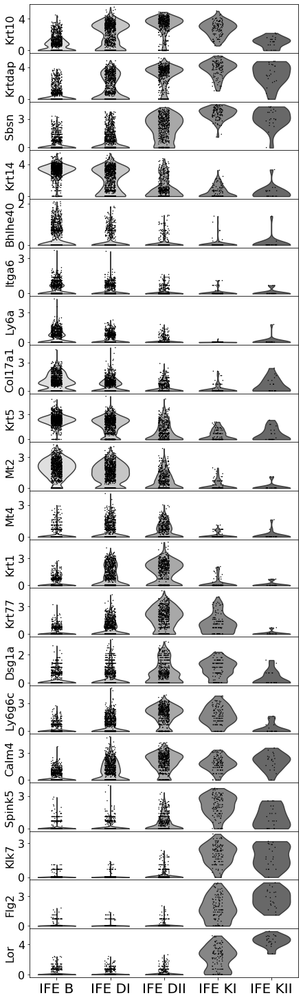

In [66]:
from matplotlib.ticker import MaxNLocator

genes = ['Krt10', 'Krtdap', 'Sbsn', 'Krt14', 'Bhlhe40', 'Itga6','Ly6a', 'Col17a1', 'Krt5', 'Mt2', 'Mt4', 'Krt1', 'Krt77', 'Dsg1a', 'Ly6g6c', 'Calm4', 'Spink5', 'Klk7', 'Flg2', 'Lor']

fig, axes = initialize_subplots(groups_to_plot=len(genes), ncols = 1, figsize_multiplier=(7,1.3), gridspec_kw= {'hspace':0})
for ix, gene in enumerate(genes):
    ax = axes[ix]
    sc.pl.violin(data_magic, keys = gene, groupby = 'pred_cluster_imp', frameon = False, ax = ax, show = False, use_raw = True, palette = colors, 
                 size = 1.5, width = 0.7)
    ax.set_xlabel('')
    if ix != len(genes)-1:
        ax.set_xticks([])
    #yticks = ax.get_yticks()
    
    ax.yaxis.set_major_locator(MaxNLocator(integer=True, nbins = 2))
    
    ax.tick_params(axis="y", labelsize=16)
    ax.tick_params(axis="x", labelsize=20)
    ax.set_ylabel(gene, fontdict = {'size':16})

#plt.savefig(os.path.join(fig_path, 'Stacked_violin_gene_expression_v2.pdf'), transparent = True, bbox_inches = 'tight', dpi = 1000)

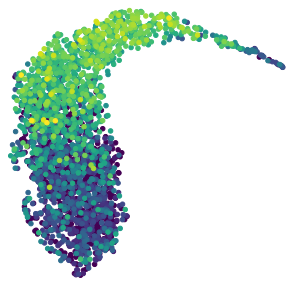

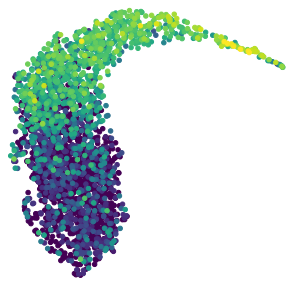

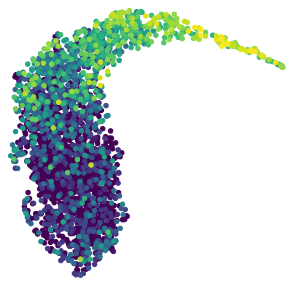

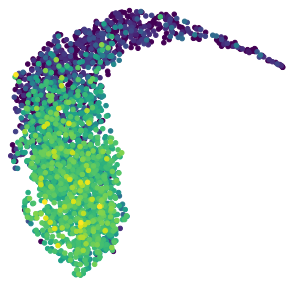

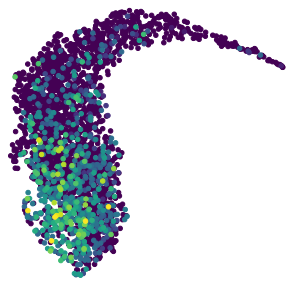

...

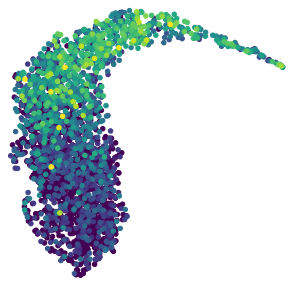

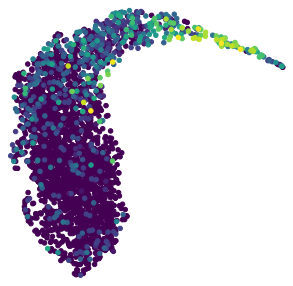

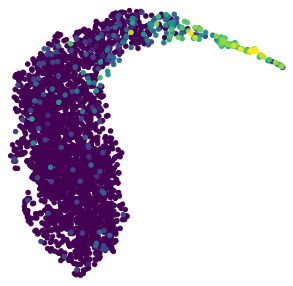

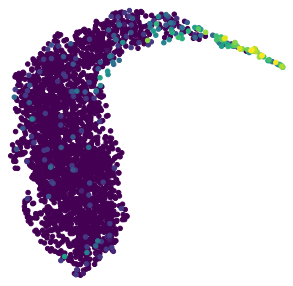

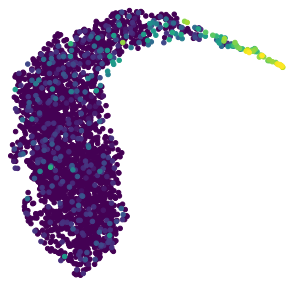

In [67]:
percentile = 99.9
add_perc = 0.2

genes = ['Krt10', 'Krtdap', 'Sbsn', 'Krt14', 'Bhlhe40', 'Itga6','Ly6a', 'Col17a1', 'Krt5', 'Mt2', 'Mt4', 'Krt1', 'Krt77', 'Dsg1a', 'Ly6g6c', 'Calm4', 'Spink5', 'Klk7', 'Flg2', 'Lor']

for gene in genes:
    fig, ax = plt.subplots(figsize = (5,5))
    
    vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)
    umap = data_magic.obsm['X_umap']
    expression = data_magic.raw.X[:,np.where(data_magic.raw.var_names == gene)[0]]
    
    expression = expression.flatten()
    rank = np.argsort(expression)
    expression = np.array(expression)[rank]
    umap = np.array(umap)[rank]
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    #plot_basal_suprabasal_cutoff(ax, color = 'k')
    #ax.set_title(gene)
    clean_axis(ax)
    
    #plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_downsampled_wider_cutoffLine_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

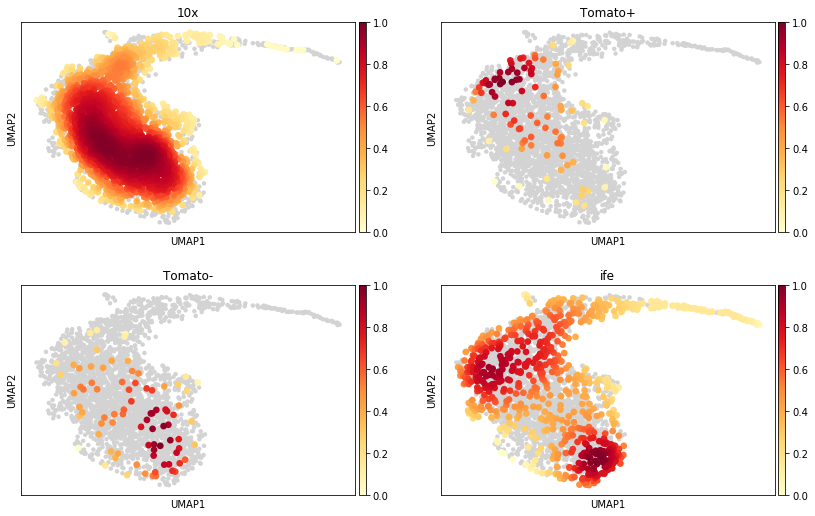

In [163]:
sc.tl.embedding_density(data_magic, basis = 'umap', groupby = 'cell_identity')
sc.pl.embedding_density(data_magic, groupby = 'cell_identity', ncols = 2)